# 데이터 확인

In [ ]:
from PIL import Image
import os

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
modaimage = os.listdir('/content/drive/MyDrive/modanet/datasets/coco/images')

# 라이브러리 설치

In [ ]:
!git clone https://github.com/facebookresearch/detectron2

Cloning into 'detectron2'...
remote: Enumerating objects: 14634, done.
remote: Counting objects: 100% (50/50), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 14634 (delta 16), reused 34 (delta 8), pack-reused 14584
Receiving objects: 100% (14634/14634), 5.99 MiB | 16.35 MiB/s, done.
Resolving deltas: 100% (10572/10572), done.


In [ ]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0


In [ ]:
import torch

In [ ]:
torch.__version__

'1.13.0+cu116'

In [ ]:
!pip install pyyaml==5.3.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
#assert torch.__version__.startswith("1.9")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 269 kB 34.4 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.3.1-cp38-cp38-linux_x86_64.whl size=44634 sha256=6927db50a08ddb3812f1b7b74e7f758091ce760bd9e353a741f40f9589c6a249
  Stored in directory: /root/.cache/pip/wheels/13/90/db/290ab3a34f2ef0b5a0f89235dc2d40fea83e77de84ed2dc05c
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 5.1
    Uninstalling PyYAML-5.1:
      Successfully uninstalled PyYAML-5.1
1.13.0+cu116 True


In [ ]:
!python setup.py install

python3: can't open file 'setup.py': [Errno 2] No such file or directory


# COCO DataSet 생성

DeepFashion2 dataset을 Deepfashion2 github에서 제공하는 deepfashion2_to_coco.py파일 활용해 COCO format으로 변환

In [ ]:
from PIL import Image
import numpy as np
import json

dataset = {
    "info": {},
    "licenses": [],
    "images": [],
    "annotations": [],
    "categories": []
}

lst_name = ['short_sleeved_shirt', 'long_sleeved_shirt', 'short_sleeved_outwear', 'long_sleeved_outwear',
            'vest', 'sling', 'shorts', 'trousers', 'skirt', 'short_sleeved_dress',
            'long_sleeved_dress', 'vest_dress', 'sling_dress']

for idx, e  in enumerate(lst_name):
    dataset['categories'].append({
        'id': idx + 1,
        'name': e,
        'supercategory': "clothes",
        'keypoints': ['%i' % (i) for i in range(1, 295)],
        'skeleton': []
    })

num_images = 32153 #191961 
sub_index = 0  # the index of ground truth instance
for num in range(1, num_images + 1):
    json_name = '/content/drive/MyDrive/validation/annos/' + str(num).zfill(6) + '.json'
    image_name = '/content/drive/MyDrive/validation/image/' + str(num).zfill(6) + '.jpg'

    if (num >= 0):
        imag = Image.open(image_name)
        width, height = imag.size
        with open(json_name, 'r') as f:
            temp = json.loads(f.read())
            pair_id = temp['pair_id']

            dataset['images'].append({
                'coco_url': '',
                'date_captured': '',
                'file_name': str(num).zfill(6) + '.jpg',
                'flickr_url': '',
                'id': num,
                'license': 0,
                'width': width,
                'height': height
            })
            for i in temp:
                if i == 'source' or i == 'pair_id':
                    continue
                else:
                    points = np.zeros(294 * 3)
                    sub_index = sub_index + 1
                    box = temp[i]['bounding_box']
                    w = box[2] - box[0]
                    h = box[3] - box[1]
                    x_1 = box[0]
                    y_1 = box[1]
                    bbox = [x_1, y_1, w, h]
                    cat = temp[i]['category_id']
                    style = temp[i]['style']
                    seg = temp[i]['segmentation']
                    landmarks = temp[i]['landmarks']

                    points_x = landmarks[0::3]
                    points_y = landmarks[1::3]
                    points_v = landmarks[2::3]
                    points_x = np.array(points_x)
                    points_y = np.array(points_y)
                    points_v = np.array(points_v)
                    case = [0, 25, 58, 89, 128, 143, 158, 168, 182, 190, 219, 256, 275, 294]
                    idx_i, idx_j = case[cat - 1], case[cat]

                    for n in range(idx_i, idx_j):
                        points[3 * n] = points_x[n - idx_i]
                        points[3 * n + 1] = points_y[n - idx_i]
                        points[3 * n + 2] = points_v[n - idx_i]

                    num_points = len(np.where(points_v > 0)[0])

                    dataset['annotations'].append({
                        'area': w * h,
                        'bbox': bbox,
                        'category_id': cat,
                        'id': sub_index,
                        'pair_id': pair_id,
                        'image_id': num,
                        'iscrowd': 0,
                        'style': style,
                        'num_keypoints': num_points,
                        'keypoints': points.tolist(),
                        'segmentation': seg,
                    })

json_name = '/content/deepfashion2_validation_.json'
with open(json_name, 'w') as f:
    json.dump(dataset, f)

KeyboardInterrupt: ignored

# Package import

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 29.2 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44089 sha256=f6d6bb7b524f87a195d5d84c315447246184b5ad011e7f71df40a62660e8d2ea
  Stored in directory: /root/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
fatal: destination path 'detectron2' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://us-python.

- timm
- iopath
- fvcore
- omegaconf
- fairscale


In [ ]:
os.chdir('/content/detectron2/detectron2')

In [ ]:
# Setup detectron2 logger

import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import os
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Training

# COCO Detection with Faster R-CNN
        "COCO-Detection/faster_rcnn_R_50_C4_1x": "137257644/model_final_721ade.pkl",
        "COCO-Detection/faster_rcnn_R_50_DC5_1x": "137847829/model_final_51d356.pkl",
        "COCO-Detection/faster_rcnn_R_50_FPN_1x": "137257794/model_final_b275ba.pkl",
        "COCO-Detection/faster_rcnn_R_50_C4_3x": "137849393/model_final_f97cb7.pkl",
        "COCO-Detection/faster_rcnn_R_50_DC5_3x": "137849425/model_final_68d202.pkl",
        "COCO-Detection/faster_rcnn_R_50_FPN_3x": "137849458/model_final_280758.pkl",
        "COCO-Detection/faster_rcnn_R_101_C4_3x": "138204752/model_final_298dad.pkl",
        "COCO-Detection/faster_rcnn_R_101_DC5_3x": "138204841/model_final_3e0943.pkl",
        "COCO-Detection/faster_rcnn_R_101_FPN_3x": "137851257/model_final_f6e8b1.pkl",
        "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x": "139173657/model_final_68b088.pkl",
        # COCO Detection with RetinaNet
        "COCO-Detection/retinanet_R_50_FPN_1x": "190397773/model_final_bfca0b.pkl",
        "COCO-Detection/retinanet_R_50_FPN_3x": "190397829/model_final_5bd44e.pkl",
        "COCO-Detection/retinanet_R_101_FPN_3x": "190397697/model_final_971ab9.pkl",
        # COCO Detection with RPN and Fast R-CNN
        "COCO-Detection/rpn_R_50_C4_1x": "137258005/model_final_450694.pkl",
        "COCO-Detection/rpn_R_50_FPN_1x": "137258492/model_final_02ce48.pkl",
        "COCO-Detection/fast_rcnn_R_50_FPN_1x": "137635226/model_final_e5f7ce.pkl",

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow

In [ ]:
import os
os.mkdir('/content/drive/Othercomputers/MacPro/12sw_project/modanet')

In [ ]:
cd /content/drive/Othercomputers/MacPro/12sw_project/

/content/drive/Othercomputers/MacPro/12sw_project


In [ ]:
!git clone https://github.com/eBay/modanet.git /content/drive/Othercomputers/MacPro/12sw_project/modanet

Cloning into '/content/drive/Othercomputers/MacPro/12sw_project/modanet'...
remote: Enumerating objects: 70, done.
remote: Total 70 (delta 0), reused 0 (delta 0), pack-reused 70
Unpacking objects: 100% (70/70), done.


In [ ]:
!git clone https://help.github.com/articles/installing-git-large-file-storage/ /content/drive/Othercomputers/MacPro/12sw_project/modanet_help

Cloning into '/content/drive/Othercomputers/MacPro/12sw_project/modanet_help'...
fatal: repository 'https://help.github.com/articles/installing-git-large-file-storage/' not found


In [ ]:
!pip install maskrcnn-modanet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 48 kB 4.0 MB/s 
     |████████████████████████████████| 60 kB 7.5 MB/s 
     |████████████████████████████████| 71 kB 9.2 MB/s 
  Created wheel for instaloader: filename=instaloader-4.9.5-py3-none-any.whl size=62314 sha256=ab8ae28a57977c6c555f91df49c8c7f87be365e486ec7a986167537f92d981c6
  Stored in directory: /root/.cache/pip/wheels/37/3a/0a/bd2c590e4fc82b1c10d3fce53139a1ed11b7b5374cdb70ca94
  Created wheel for keras-maskrcnn: filename=keras_maskrcnn-0.2.2-py3-none-any.whl size=41692 sha256=e4c0d7e0686ce039dd49dc73f2577996b6e6925c57ab0024122004c2fc4d168d
  Stored in directory: /root/.cache/pip/wheels/df/6a/b0/d5d80a51d5ca0abe14473b55c1d6b83640ecf8d6909f724b2a
  Created wheel for keras-retinanet: filename=keras_retinanet-1.0.0-cp38-cp38-linux_x86_64.whl size=168518 sha256=a1b539cc2513221cdc13122aefb787ee1844b8c9948c180322299cb1653d56a6
  Stored in di

In [ ]:
!pip3 install --upgrade cython

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!maskrcnn-modanet datasets download /content/drive/MyDrive/modanet  

/content/drive/MyDrive/modanet/
/usr/local/lib/python3.8/dist-packages/maskrcnn_modanet/
Do you want to download the whole 1 million images (what I had to do) or to just download the 50k annotated with ModaNet?
Y for 1 million (40 GB), N for 50k: N
downloading paperdoll dataset
			taken from here:
			https://github.com/kyamagu/paperdoll/tree/master/data/chictopia
			
Error: Failed to call git rev-parse --git-dir --show-toplevel: "fatal: not a git repository (or any of the parent directories): .git\n"
Git LFS initialized.
/root/.maskrcnn-modanet
saving your path location
/content/drive/MyDrive/modanet/
fast download:
True
Skipping downloading PaperDoll
/content/drive/MyDrive/modanet/datasets
\n now downloading modanet annotations\n \t\t\ttaken from here:\n \t\t\thttps://github.com/eBay/modanet
Cloning into 'modanet'...
remote: Enumerating objects: 70, done.
remote: Total 70 (delta 0), reused 0 (delta 0), pack-reused 70
Unpacking objects: 100% (70/70), done.
Filtering content: 100% (2/2)

In [ ]:
!git clone https://github.com/kim-seong-rok/detectron2_repo.git /content/drive/MyDrive/modanet/reference

Cloning into '/content/drive/MyDrive/modanet/reference'...
remote: Enumerating objects: 997, done.
remote: Counting objects: 100% (997/997), done.
remote: Compressing objects: 100% (784/784), done.
remote: Total 997 (delta 197), reused 971 (delta 189), pack-reused 0
Receiving objects: 100% (997/997), 1.19 MiB | 3.90 MiB/s, done.
Resolving deltas: 100% (197/197), done.
Checking out files: 100% (832/832), done.


In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
from detectron2.data.datasets import register_coco_instances
#register_coco_instances("deepfashion_train", {}, "/content/DeepFashion2/deepfashion2_train.json", "/content/DeepFashion2/train/image")

register_coco_instances("modanet_train", {}, "/content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json", "/content/drive/MyDrive/modanet/datasets/coco/images")
moda_metadata = MetadataCatalog.get("modanet_train")
dataset_dicts = DatasetCatalog.get("modanet_train")

[12/07 05:29:48 d2.data.datasets.coco]: Loading /content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json takes 8.68 seconds.
[12/07 05:29:48 d2.data.datasets.coco]: Loaded 52254 images in COCO format from /content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json


In [ ]:
moda_metadata = MetadataCatalog.get("modanet_train")
dataset_dicts = DatasetCatalog.get("modanet_train")

[12/07 05:30:23 d2.data.datasets.coco]: Loading /content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json takes 5.03 seconds.
[12/07 05:30:23 d2.data.datasets.coco]: Loaded 52254 images in COCO format from /content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json


In [ ]:
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("modanet_train",)
# cfg.DATASETS.VALIDATION = ()
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
\]\

\
\







\\\\\\\\\\\\\\\\
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.002
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 10000
cfg.SOLVER.STEPS = []
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 320
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13
cfg.TEST.EVAL_PERIOD = 500

os.makedirs('/content/drive/MyDrive/cfg.OUTPUT_DIR', exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/07 05:40:22 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[12/07 05:40:51 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.8/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[12/07 05:41:33 d2.utils.events]:  eta: 4:44:29  iter: 19  total_loss: 4.03  loss_cls: 2.666  loss_box_reg: 0.422  loss_mask: 0.693  loss_rpn_cls: 0.217  loss_rpn_loc: 0.04427  time: 1.6222  data_time: 1.1525  lr: 3.9962e-05  max_mem: 2550M
[12/07 05:42:01 d2.utils.events]:  eta: 4:37:44  iter: 39  total_loss: 3.003  loss_cls: 1.706  loss_box_reg: 0.4915  loss_mask: 0.6901  loss_rpn_cls: 0.141  loss_rpn_loc: 0.03804  time: 1.4819  data_time: 0.8722  lr: 7.9922e-05  max_mem: 2550M
[12/07 05:42:10 d2.utils.events]:  eta: 2:39:12  iter: 59  total_loss: 2.461  loss_cls: 0.9109  loss_box_reg: 0.7052  loss_mask: 0.6828  loss_rpn_cls: 0.1415  loss_rpn_loc: 0.03781  time: 1.1405  data_time: 0.0079  lr: 0.00011988  max_mem: 2550M
[12/07 05:42:21 d2.utils.events]:  eta: 1:29:40  iter: 79  total_loss: 2.379  loss_cls: 0.858  loss_box_reg: 0.7238  loss_mask: 0.676  loss_rpn_cls: 0.06669  loss_rpn_loc: 0.03354  time: 0.9777  data_time: 0.0070  lr: 0.00015984  max_mem: 2551M
[12/07 05:42:31 d2.utils

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output
# %reload_ext tensorboard
# %tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join('/content/output', "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg.DATASETS.TEST = ("modanet_train", )
predictor = DefaultPredictor(cfg)

[12/07 07:17:56 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

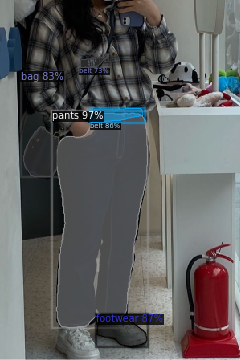

70 141 184 409
124.51993927849054


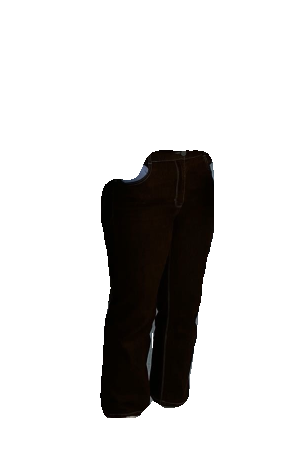

121 393 183 433
125.00009629653407


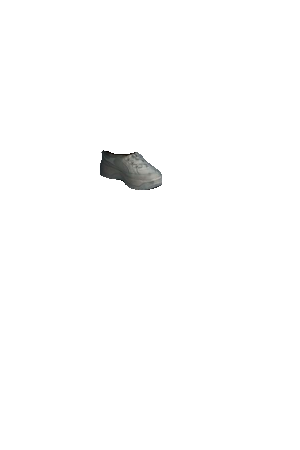

113 135 178 153
125.00410935223373


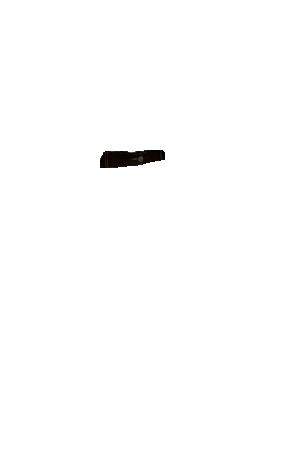

29 158 73 220
125.02412862889338


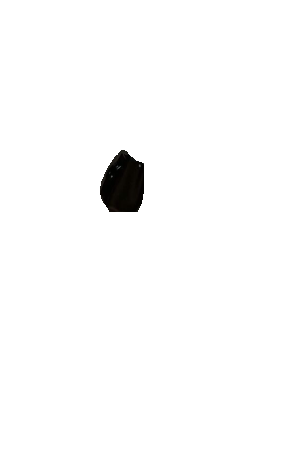

100 68 135 84
125.0006716182048


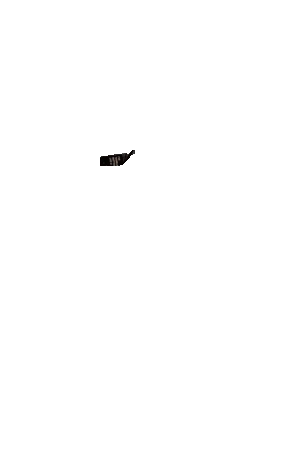

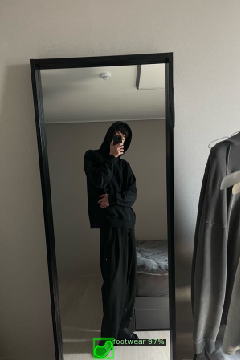

118 426 140 446
125.0


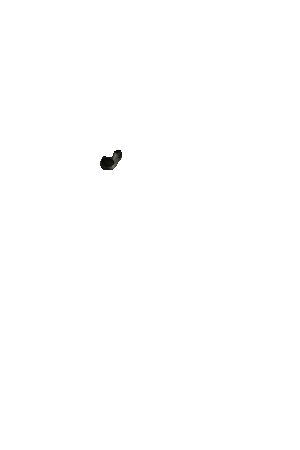

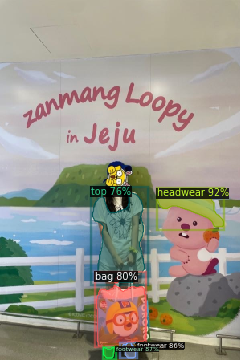

196 235 279 283
125.0


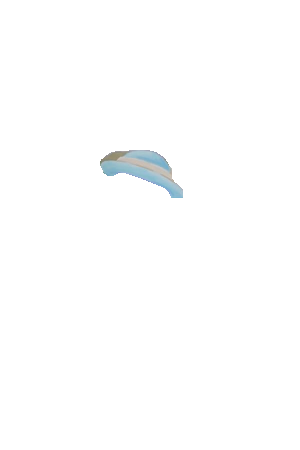

129 434 142 447
125.00162311740604


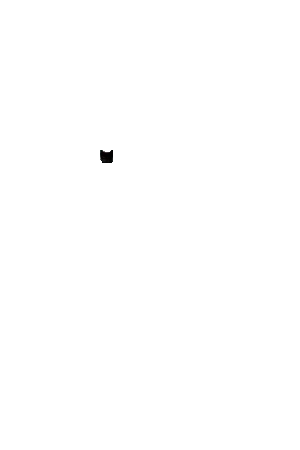

152 429 169 447
125.00049054224672


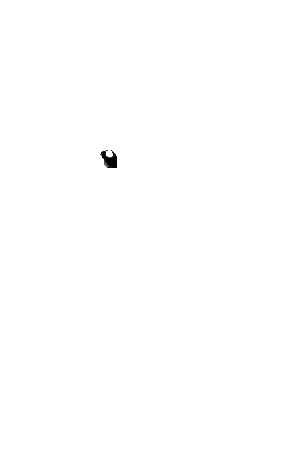

120 344 182 432
125.00117292349329


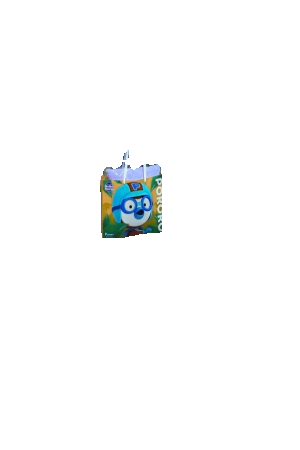

115 240 180 353
125.00000493832037


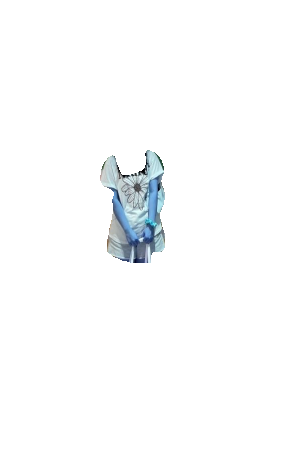

131 430 168 447
125.00198530283276


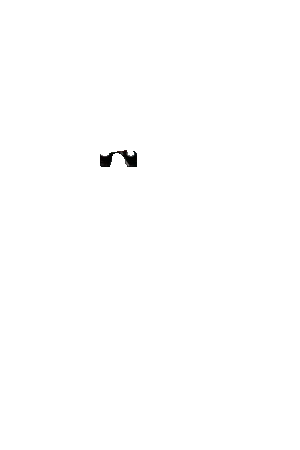

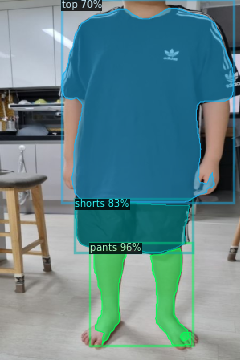

117 307 238 431
125.0


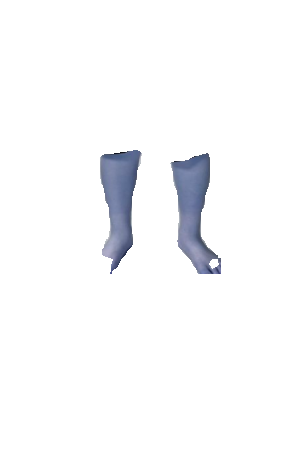

94 252 237 315
125.00124783830123


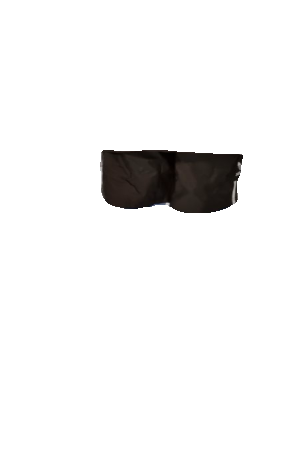

77 10 291 252
124.9943738743633


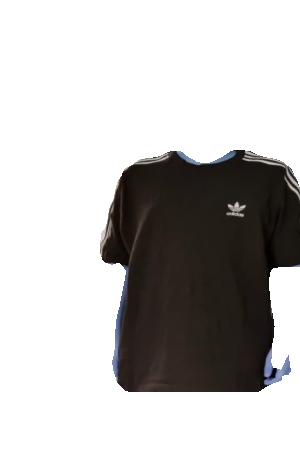

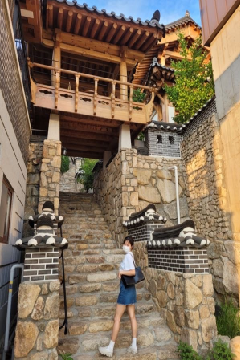

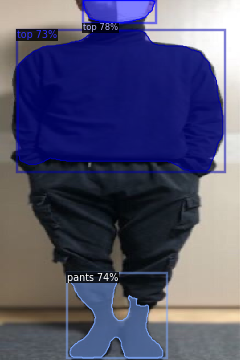

104 0 193 28
125.0


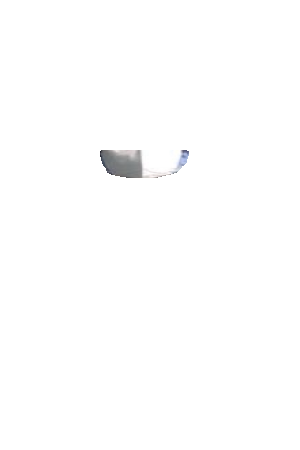

87 346 203 447
125.0


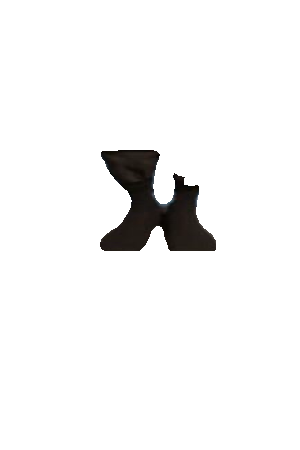

22 38 278 213
124.99969874162896


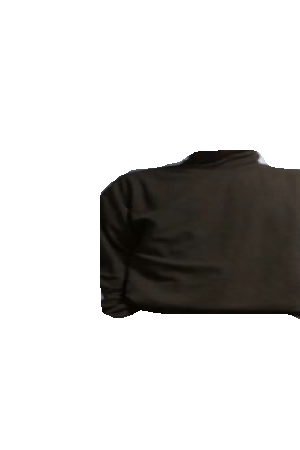

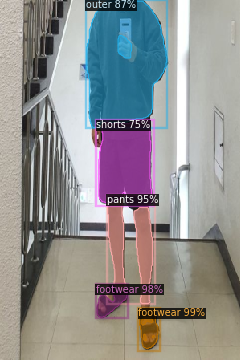

173 386 197 435
125.0


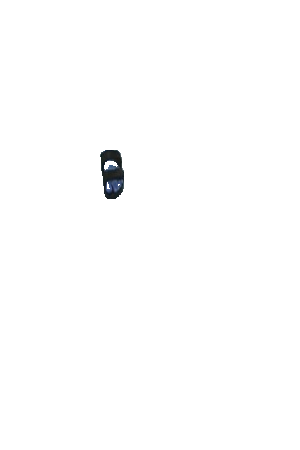

121 356 159 396
125.0


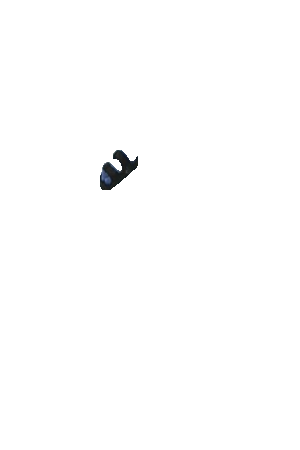

134 248 190 379
125.0


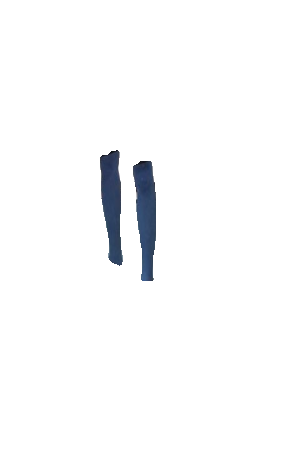

108 1 208 159
125.0


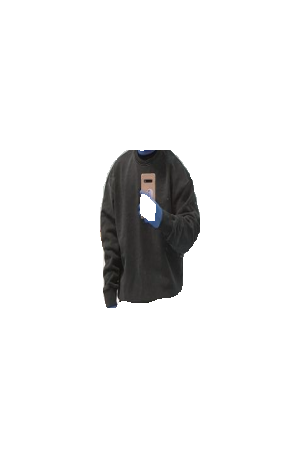

123 151 189 256
125.0


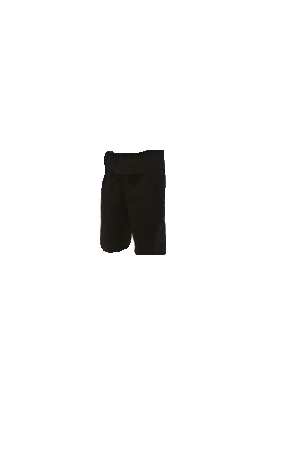

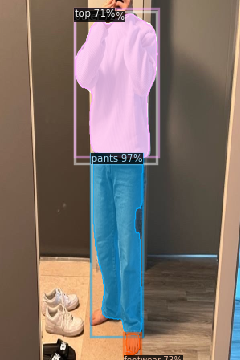

116 192 178 419
125.0


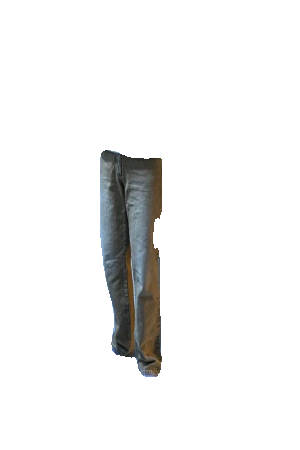

157 417 174 443
125.0


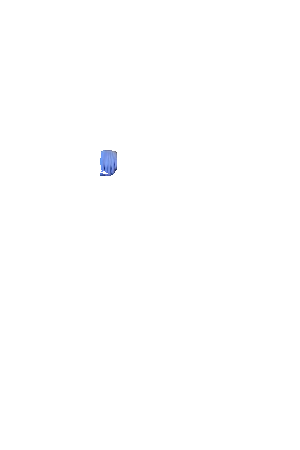

94 17 195 196
125.0


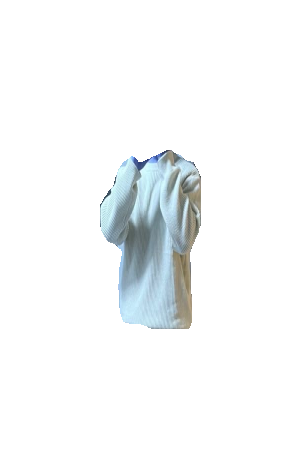

94 17 196 195
125.0


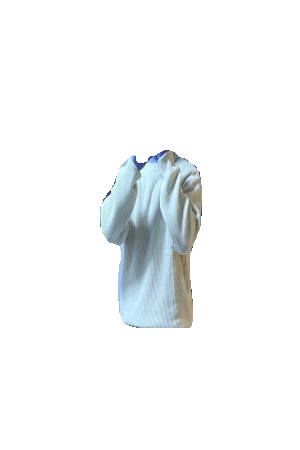

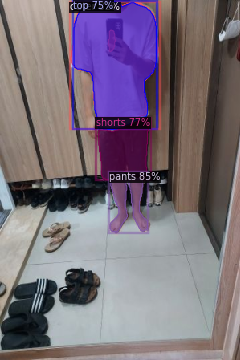

137 216 184 290
125.0


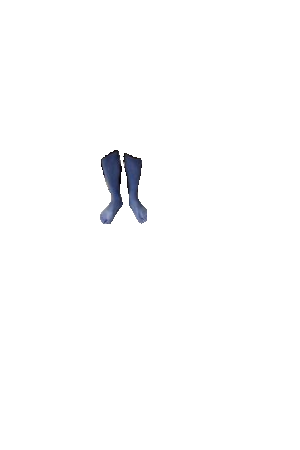

88 3 197 160
125.0


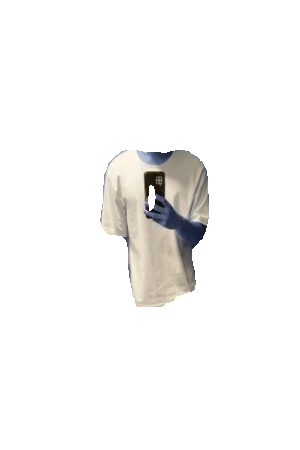

122 148 185 224
125.00019259449476


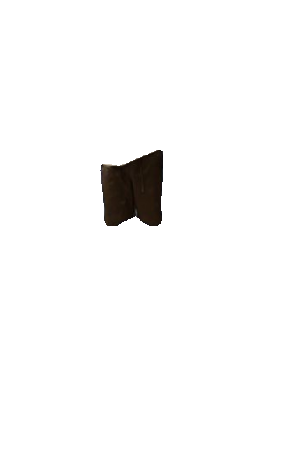

92 2 195 161
125.0


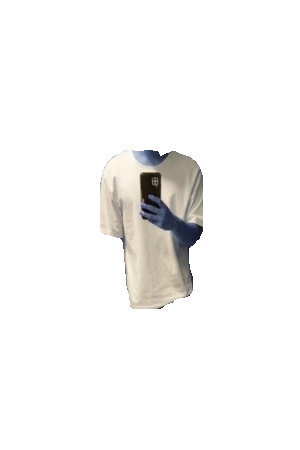

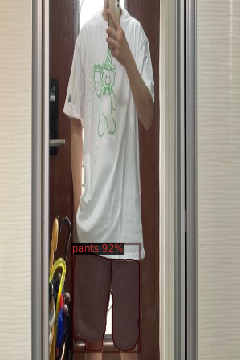

90 306 174 438
125.0


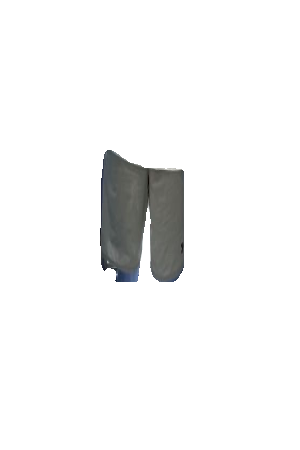

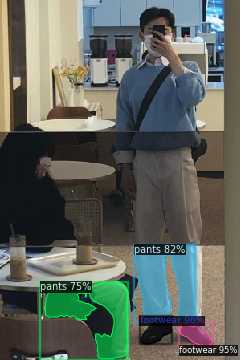

176 396 213 429
125.0


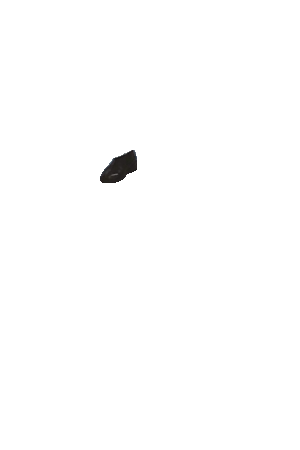

225 404 265 432
125.0


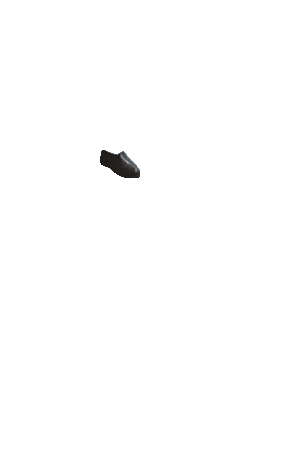

168 306 243 402
125.0


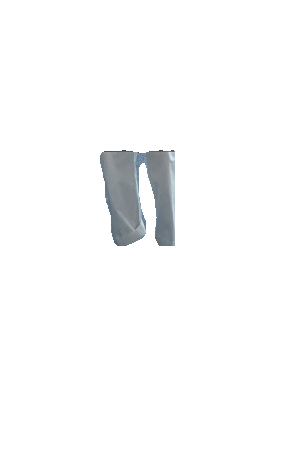

55 353 159 448
125.0


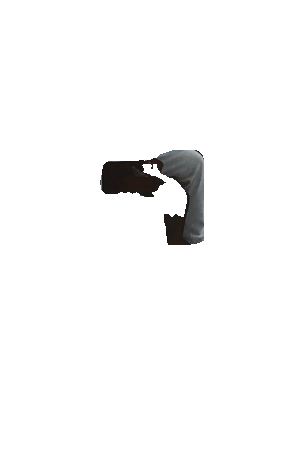

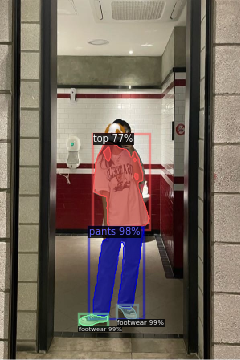

147 381 170 399
125.0


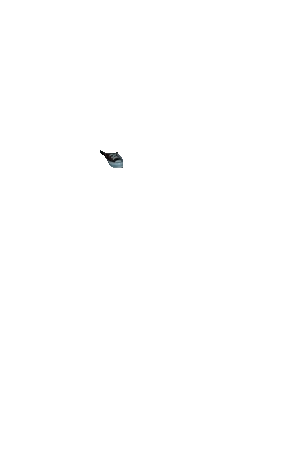

99 393 134 407
125.0


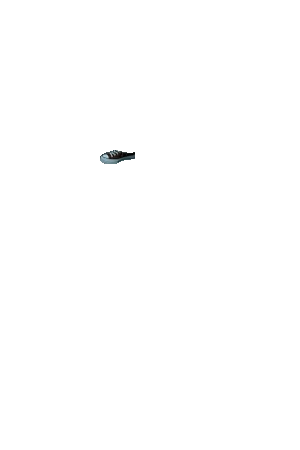

116 284 179 395
125.00006419768938


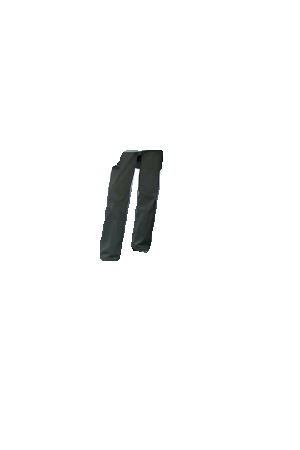

117 177 186 284
125.0


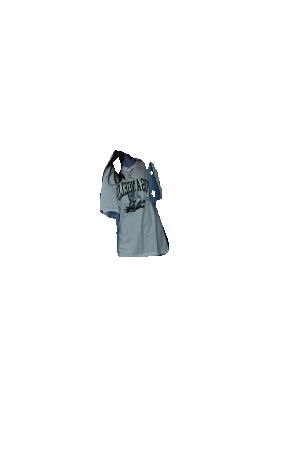

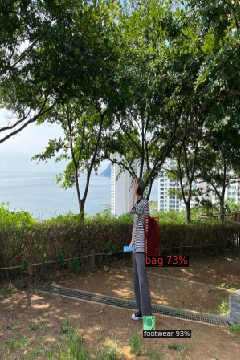

180 396 191 412
125.0


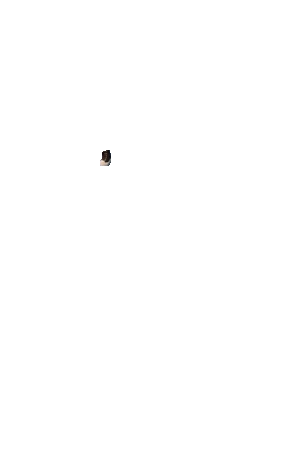

184 273 196 319
125.00198941830298


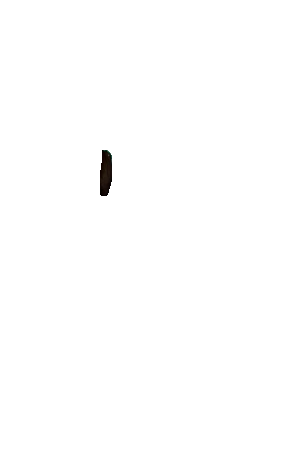

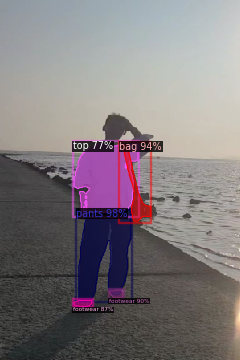

98 262 163 376
125.0


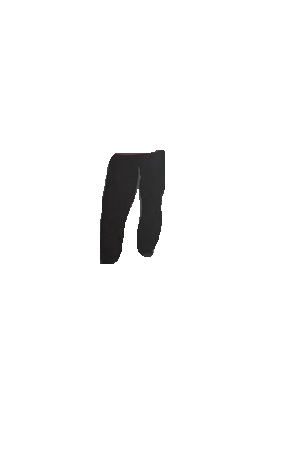

152 180 188 276
125.0


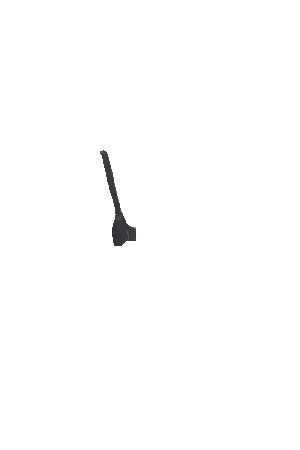

136 362 153 372
125.0


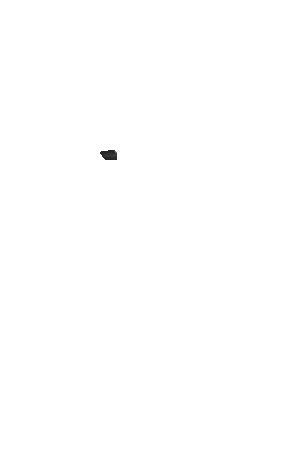

92 375 114 383
125.0


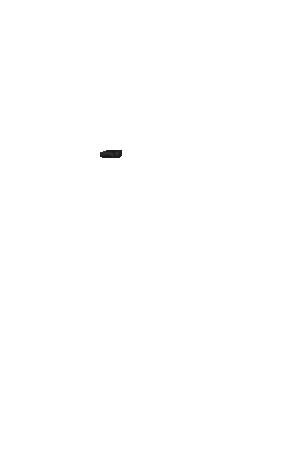

92 178 172 269
125.0


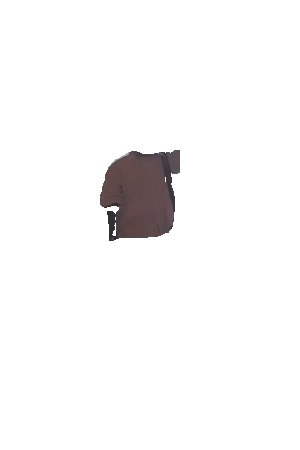

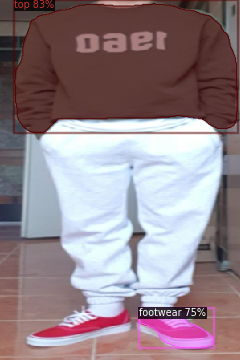

18 4 296 165
125.0


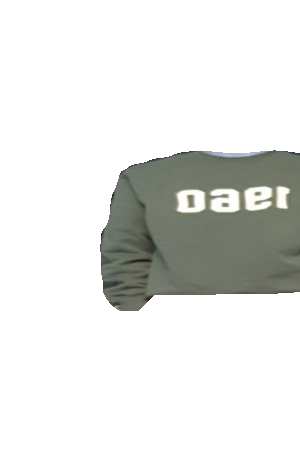

174 389 266 434
125.0


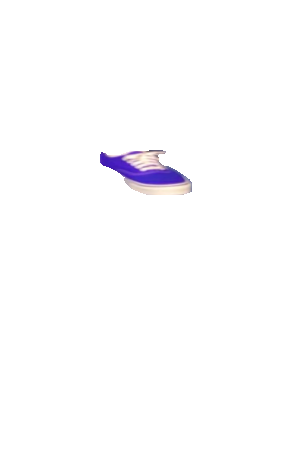

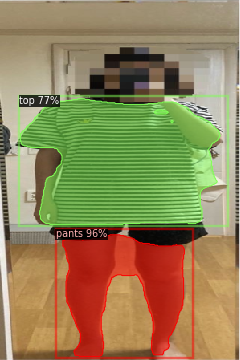

78 293 230 445
125.00006913597318


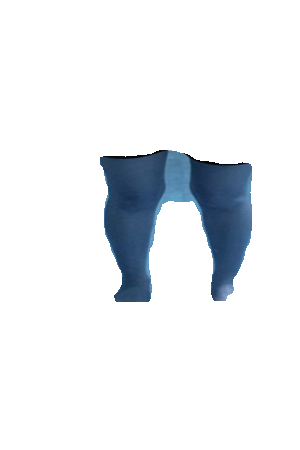

25 123 275 280
124.99935800091362


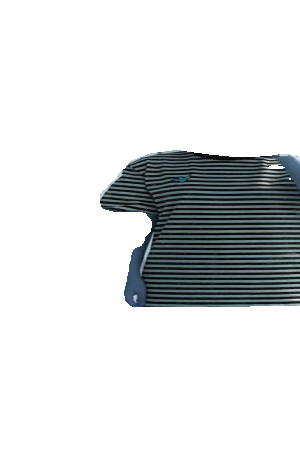

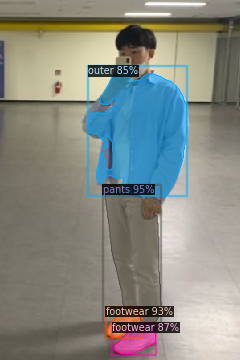

131 236 201 403
125.0


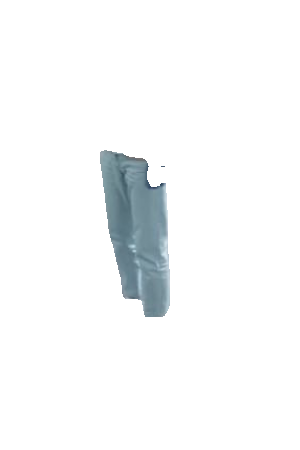

134 384 174 421
125.0


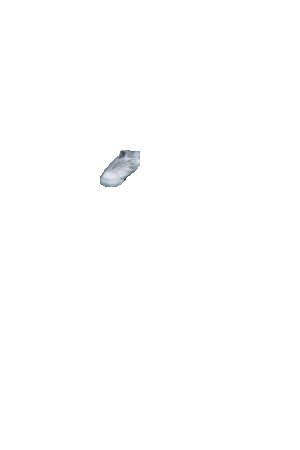

142 404 194 442
125.0


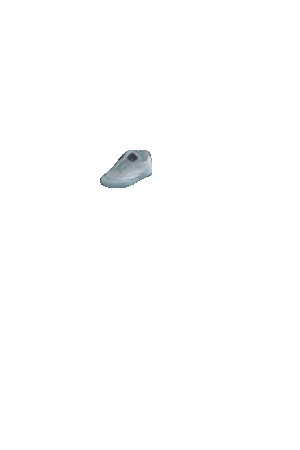

111 84 233 244
125.0


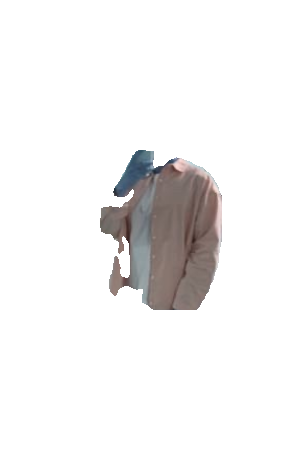

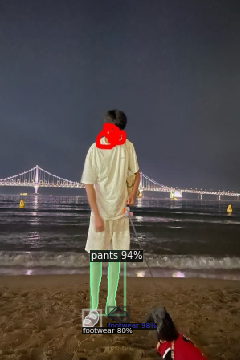

135 384 160 402
125.0


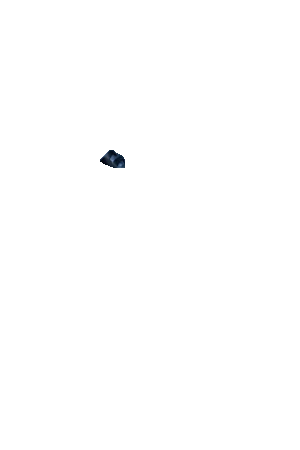

113 315 150 392
125.0


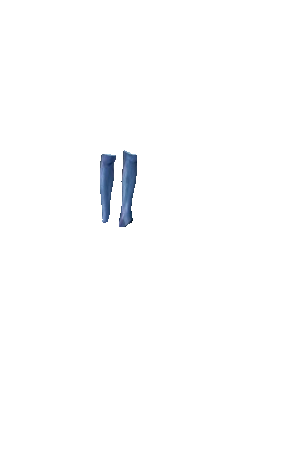

104 388 123 408
125.0010255473221


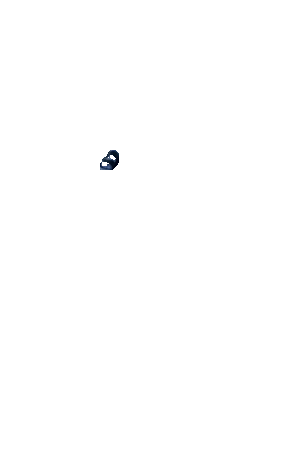

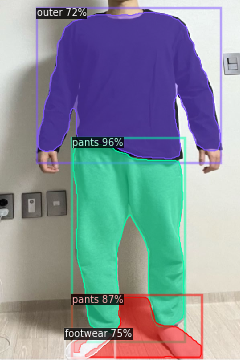

91 175 229 417
125.0


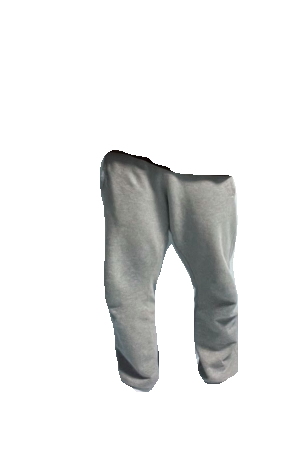

92 371 251 446
125.0


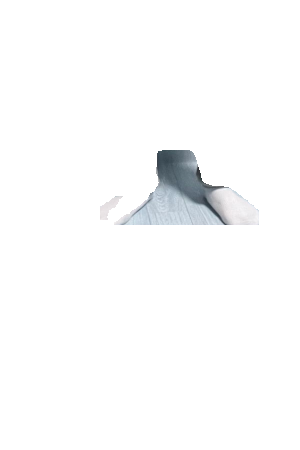

82 412 141 447
125.0


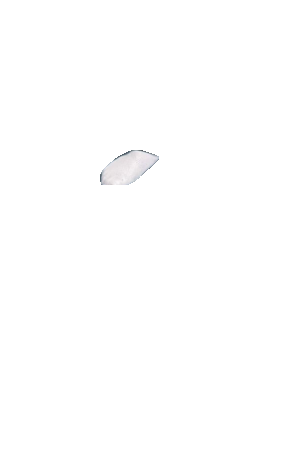

46 15 275 198
124.99944440328913


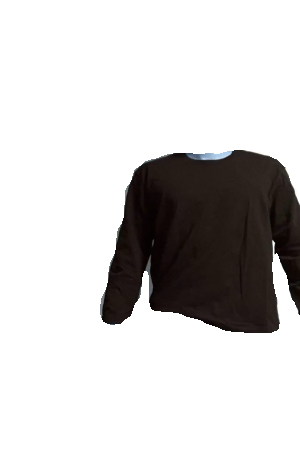

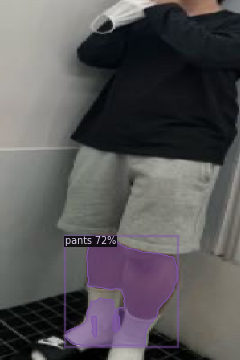

83 296 221 432
124.99957858833677


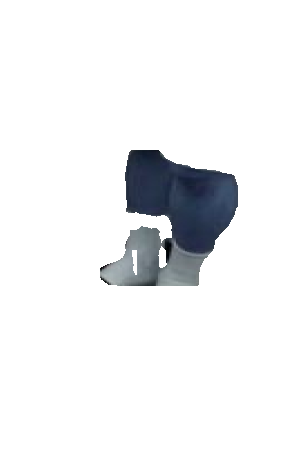

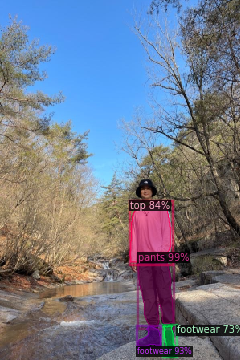

172 317 216 408
125.0007292433154


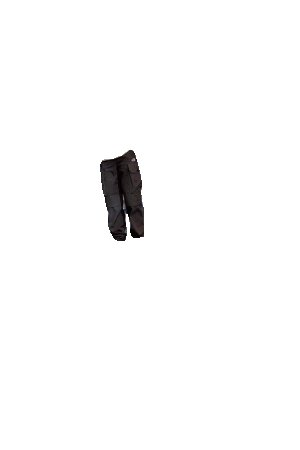

172 408 200 433
125.0


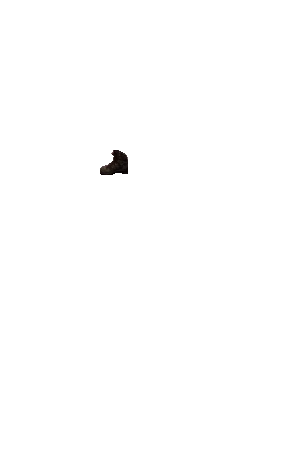

162 251 213 327
125.0


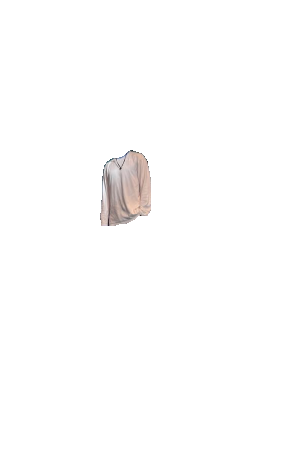

204 407 219 445
125.00018271695168


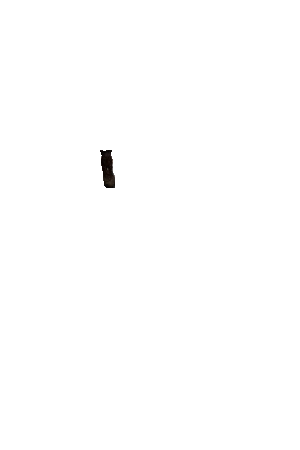

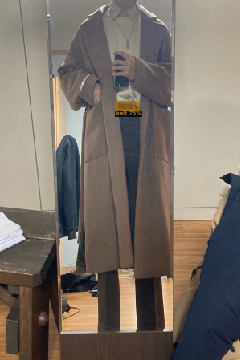

146 128 173 138
125.0


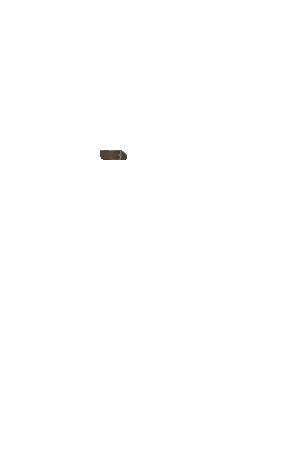

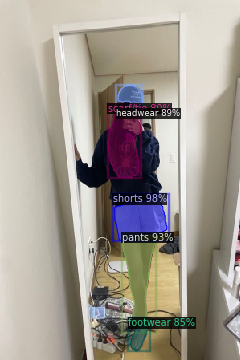

142 243 208 300
125.0


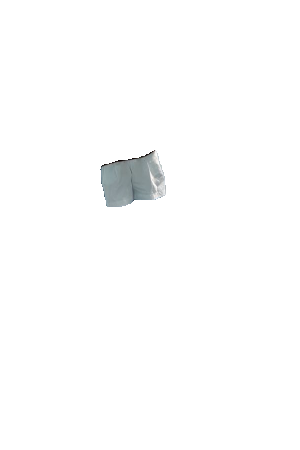

153 292 194 415
125.0


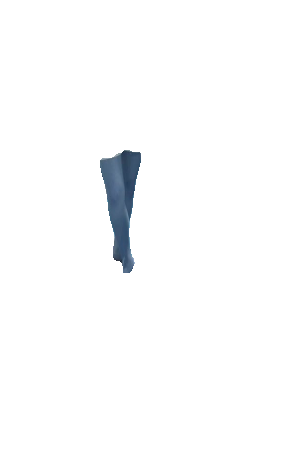

147 106 178 133
125.0


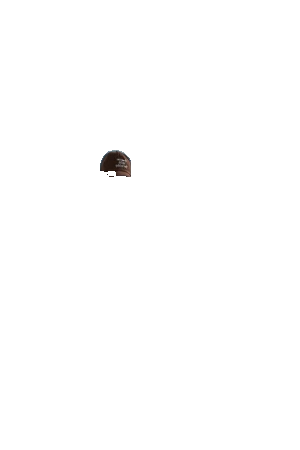

162 400 185 437
125.0


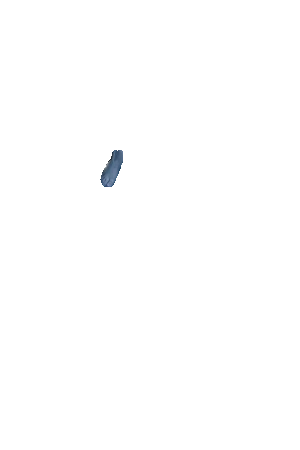

135 131 176 221
125.00059672402625


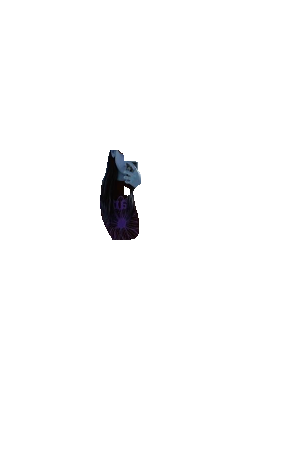

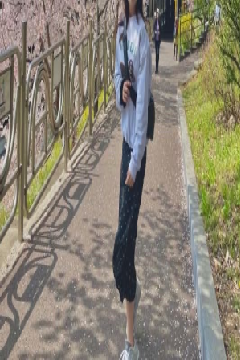

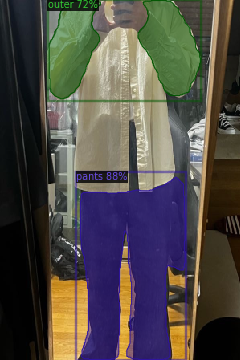

100 221 231 449
124.99941645081931


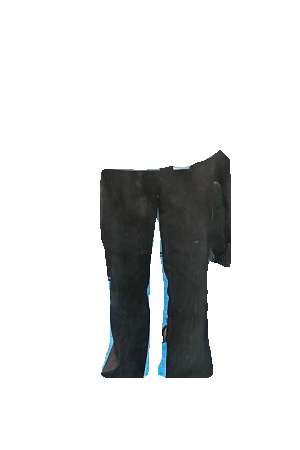

61 0 250 123
125.0


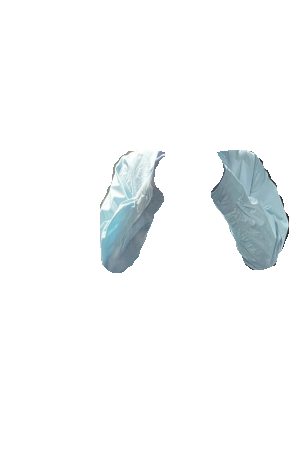

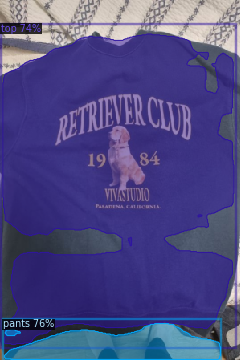

5 404 275 449
124.99969793642015


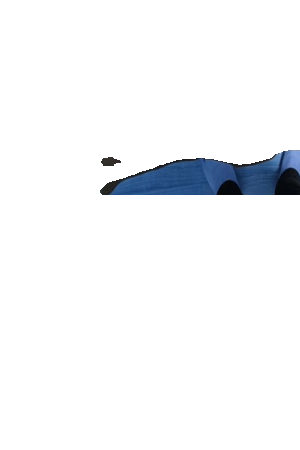

3 42 292 430
125.0


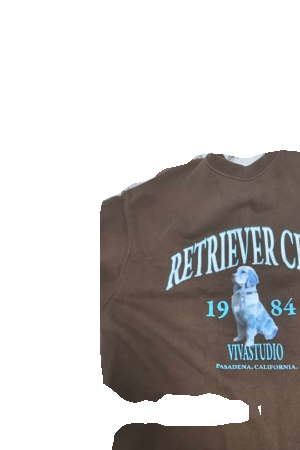

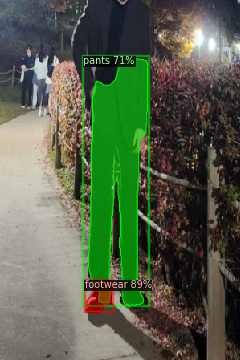

107 351 138 389
125.0


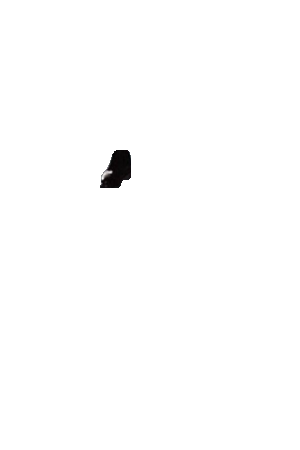

110 73 184 381
125.0


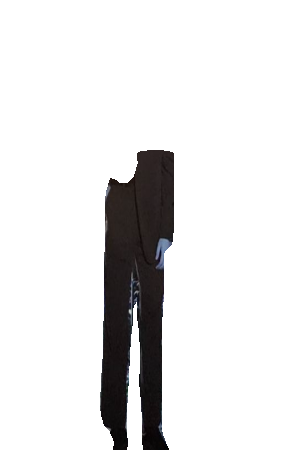

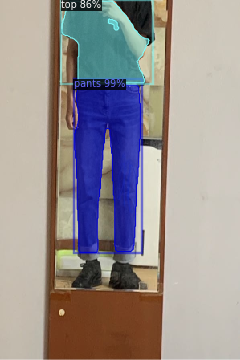

93 103 175 315
125.0


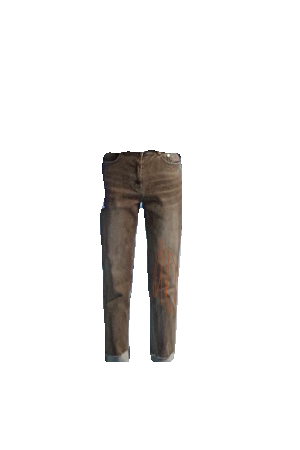

77 1 186 103
125.0001399228778


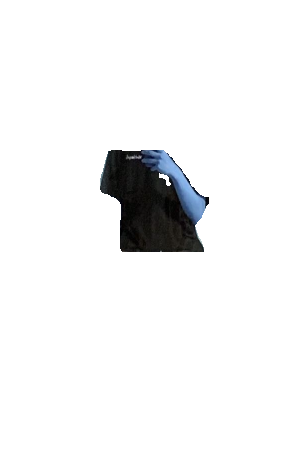

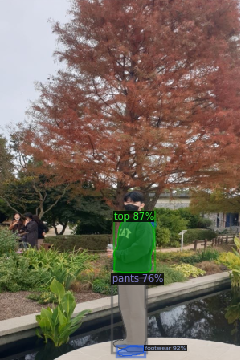

147 432 179 444
125.0


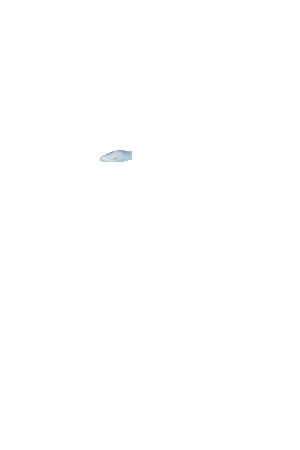

142 268 192 340
125.0


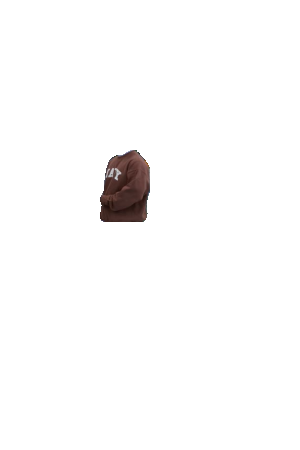

141 345 183 439
125.0


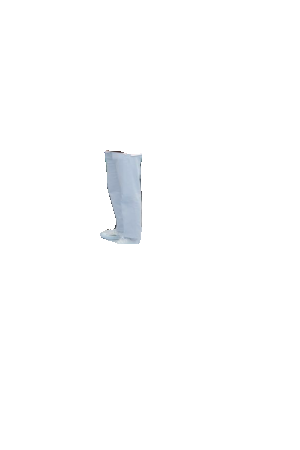

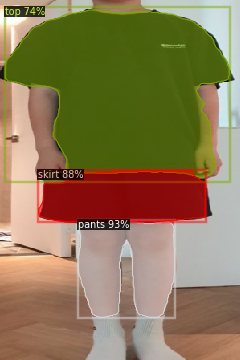

97 277 218 396
125.0


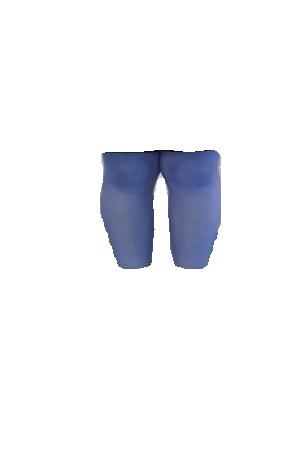

48 213 256 277
125.0


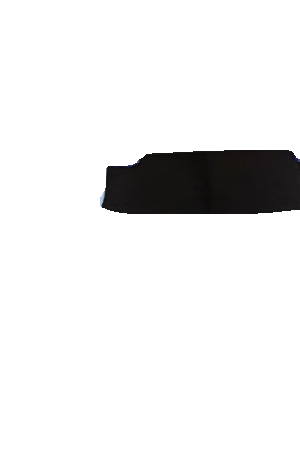

6 12 286 222
125.0


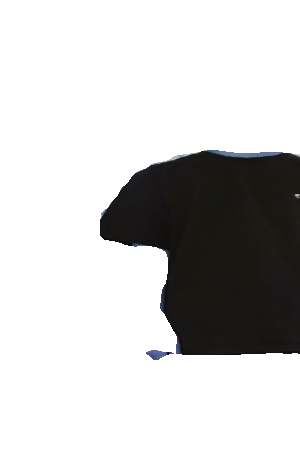

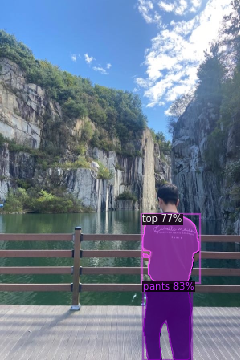

179 353 239 449
125.01464167066082


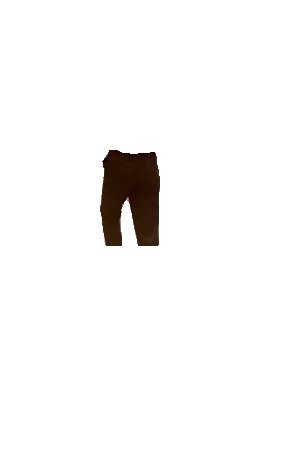

178 268 248 352
125.00367239382287


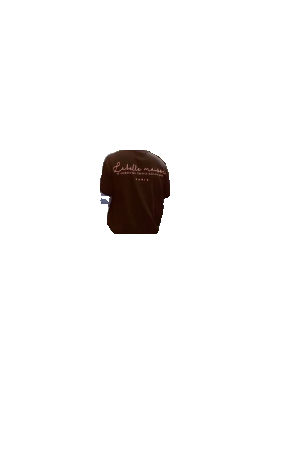

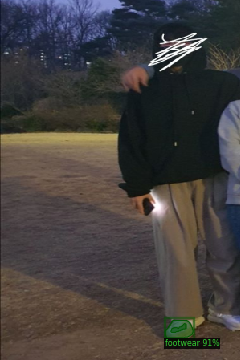

206 400 241 422
125.0


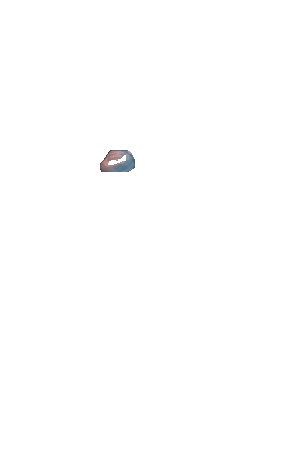

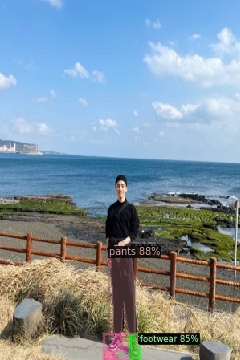

138 310 168 419
125.00613057482167


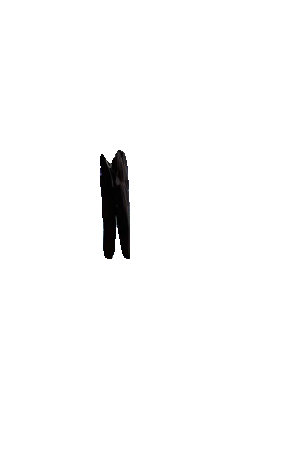

163 419 173 447
125.00019753183966


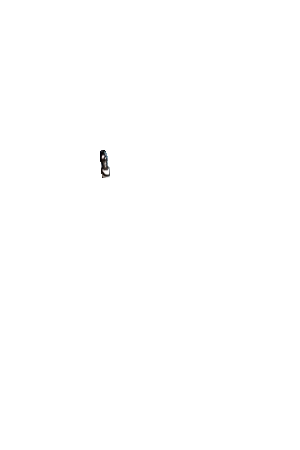

131 418 172 448
125.0005012419937


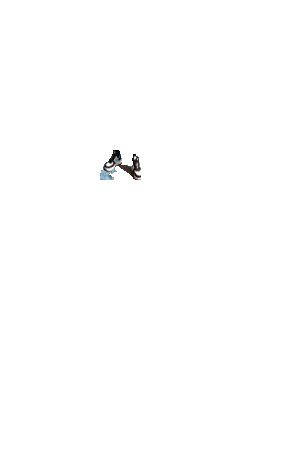

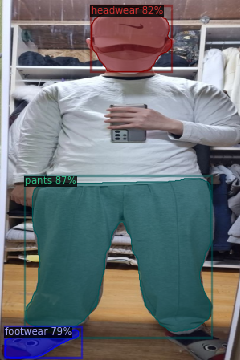

32 223 263 414
125.0


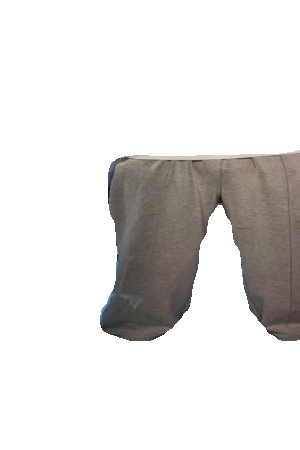

114 8 214 89
125.0


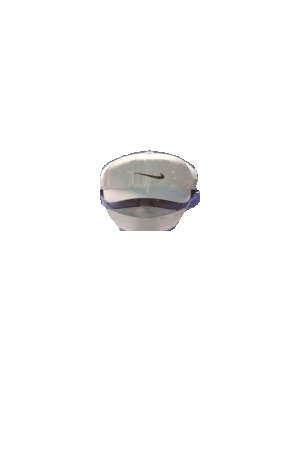

6 412 98 447
125.0


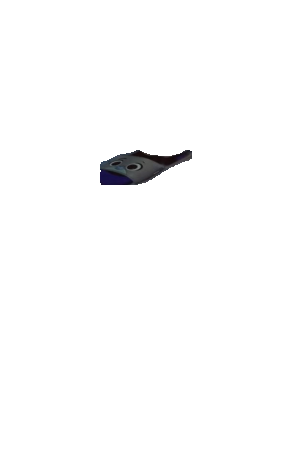

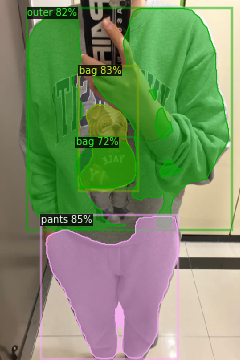

57 270 222 448
125.0


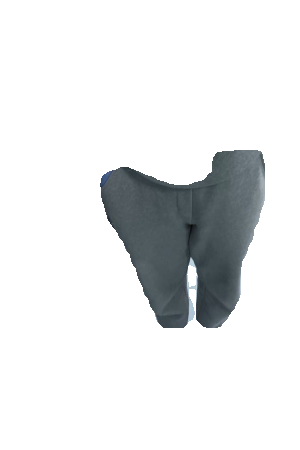

100 130 169 236
125.0


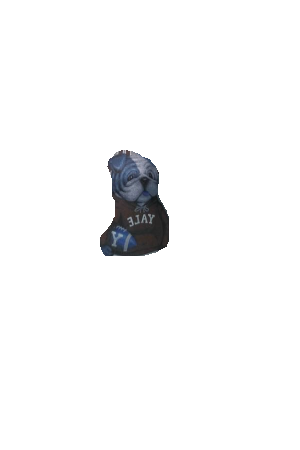

35 10 285 286
125.0


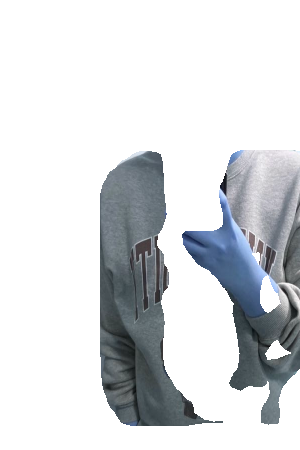

97 172 170 234
125.0


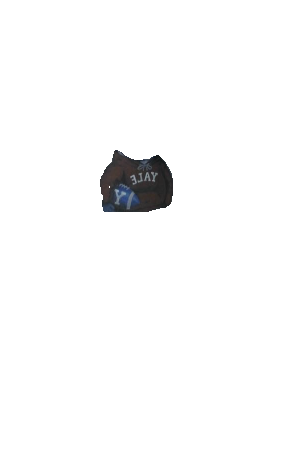

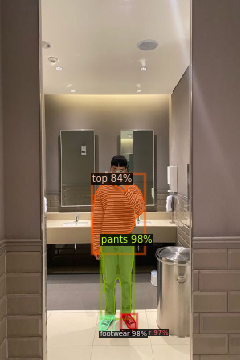

125 396 141 412
125.0


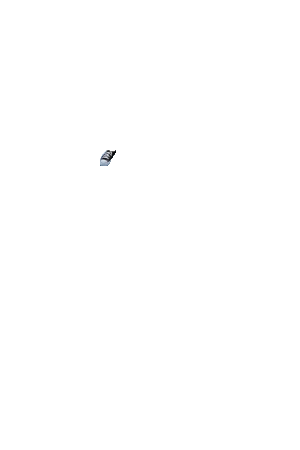

126 294 166 397
125.00004526760148


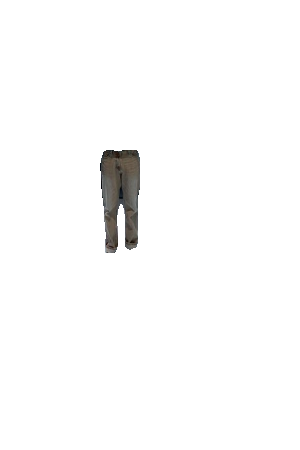

152 393 169 411
125.0


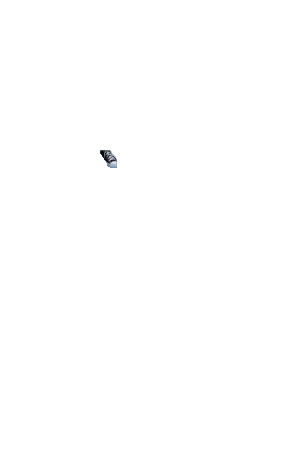

115 226 179 317
125.00007489730427


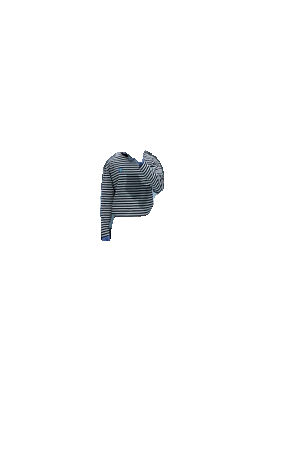

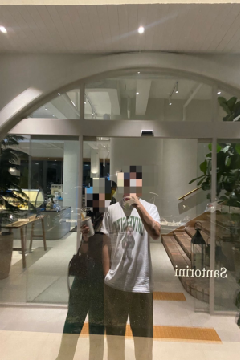

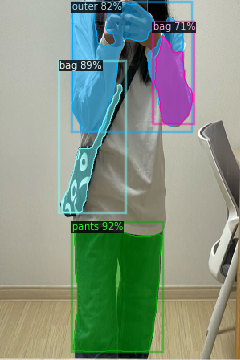

91 280 202 439
125.00000493853987


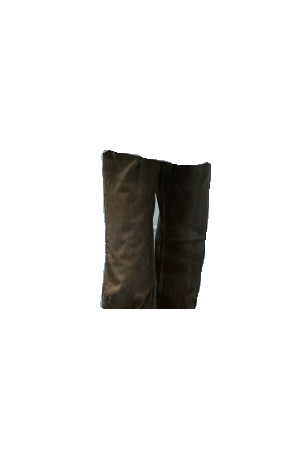

77 105 152 265
124.99991522298824


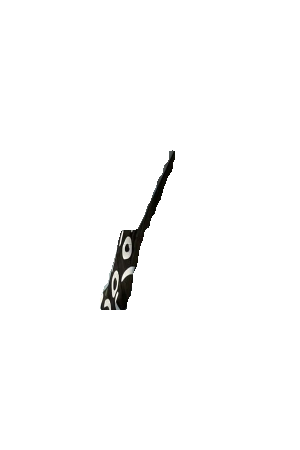

90 3 238 164
125.00006337479856


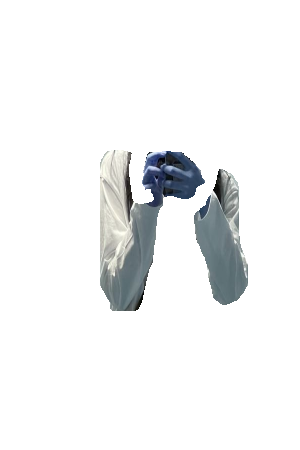

193 44 240 154
125.0


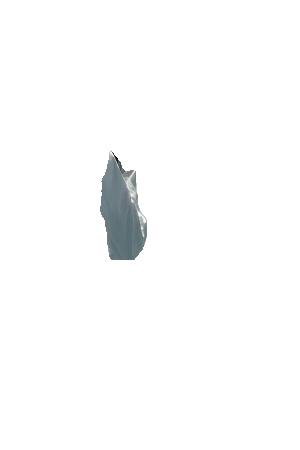

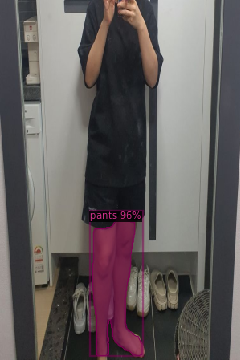

115 270 177 444
125.0


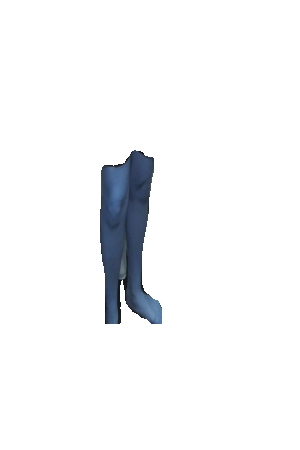

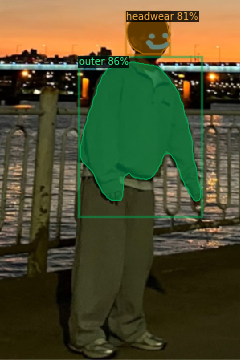

100 77 250 251
124.99560379851566


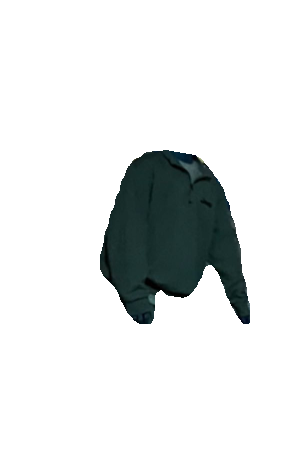

158 16 211 67
125.03136800188555


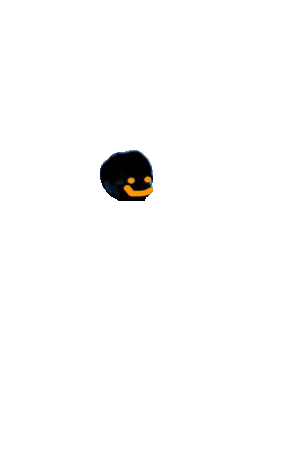

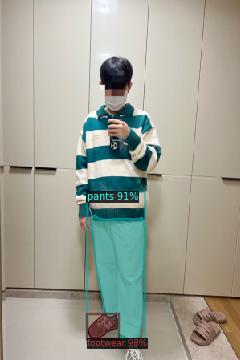

110 393 146 422
125.0


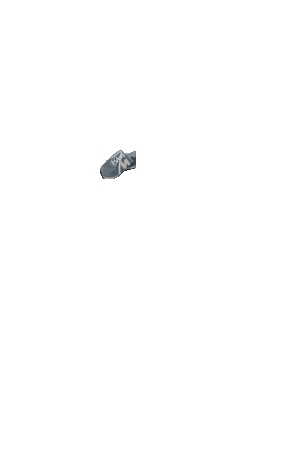

113 247 180 426
125.00016214071839


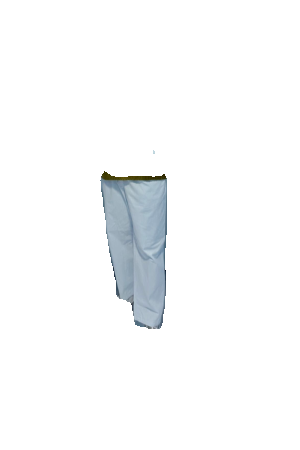

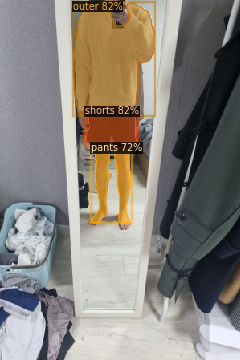

91 3 192 143
125.0


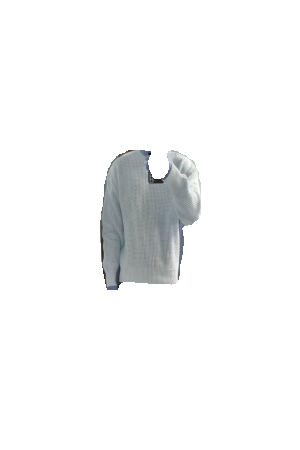

107 135 170 183
125.0


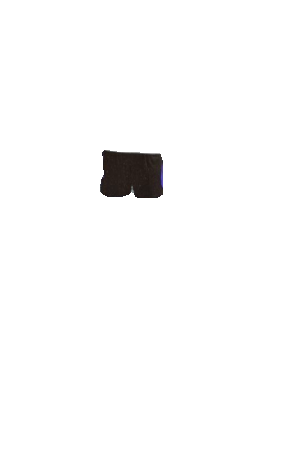

114 179 163 278
125.0


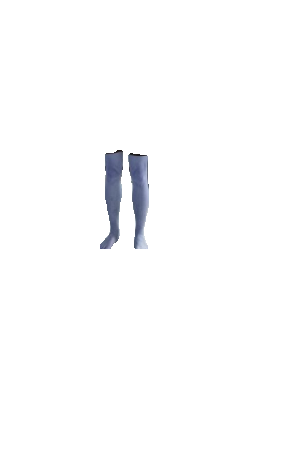

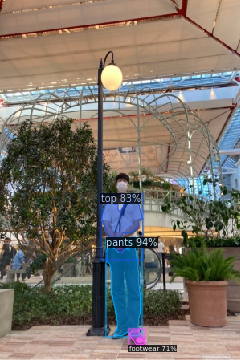

133 299 175 419
125.0011885243203


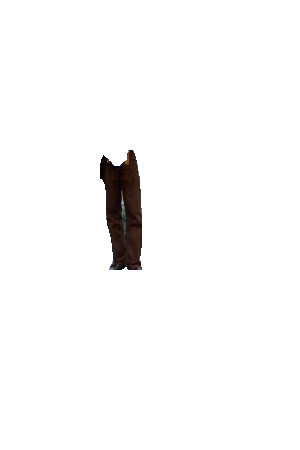

127 246 177 323
125.0


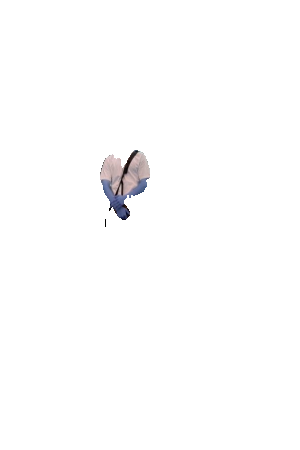

162 412 180 431
125.0


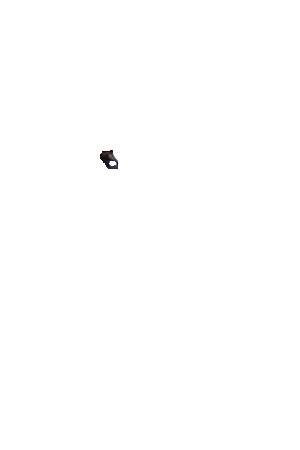

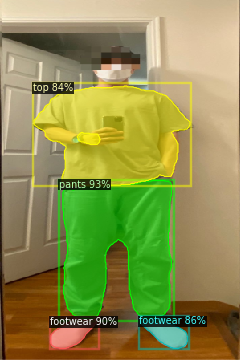

78 225 214 398
125.0000131687568


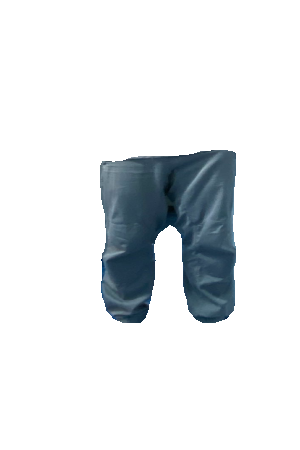

63 397 120 435
125.0


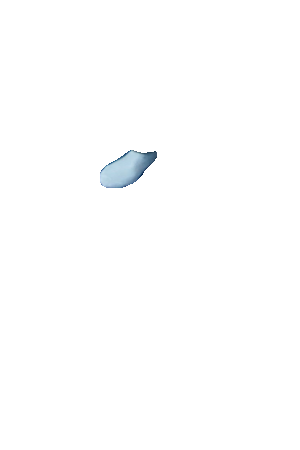

176 397 234 435
125.0


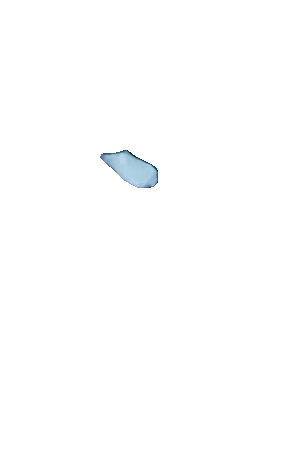

42 107 237 231
125.0


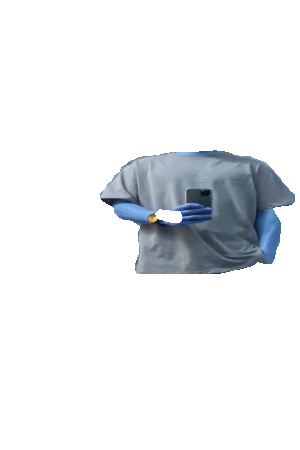

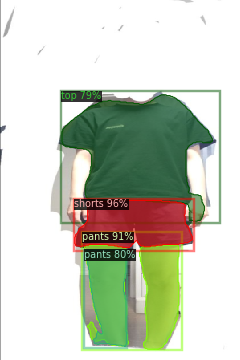

93 250 240 309
125.0


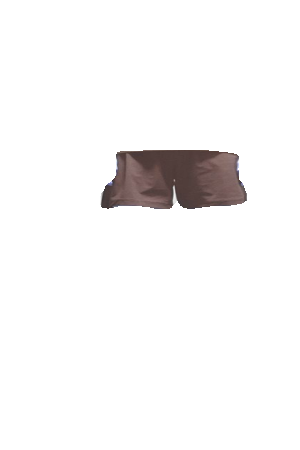

105 306 223 436
125.0


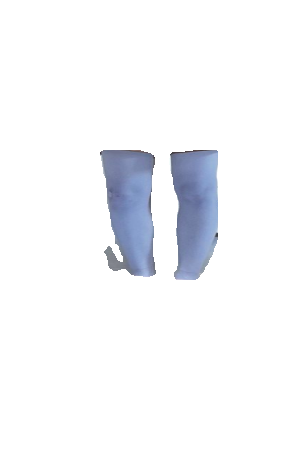

107 312 158 433
125.0


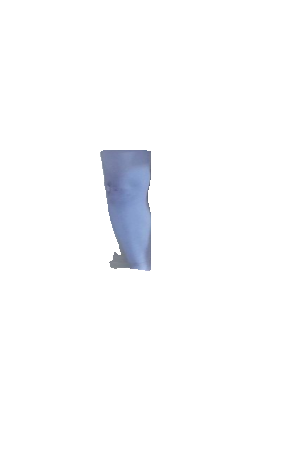

77 118 265 276
125.0


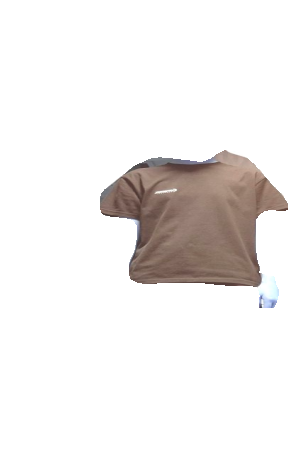

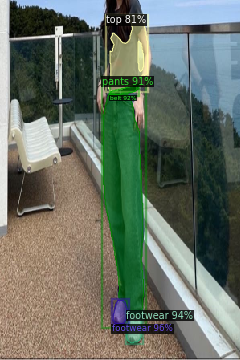

141 375 159 404
125.0


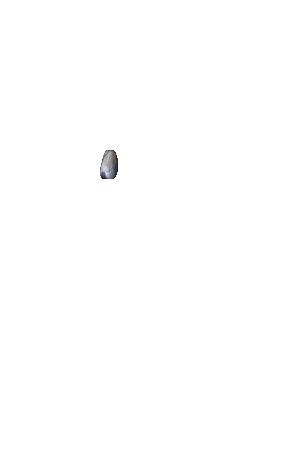

158 389 176 428
125.0


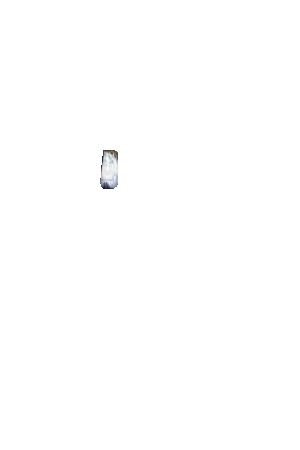

138 105 173 118
125.00014238753442


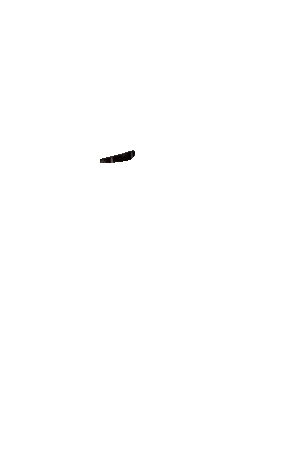

129 115 179 394
124.99773316541966


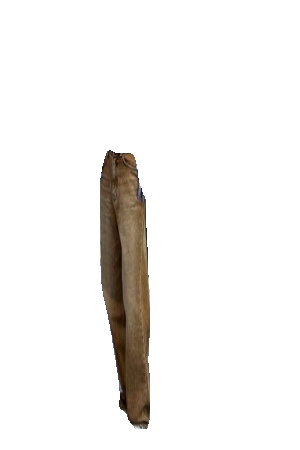

135 19 184 113
125.00093995482949


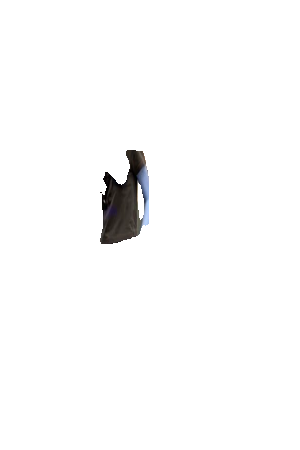

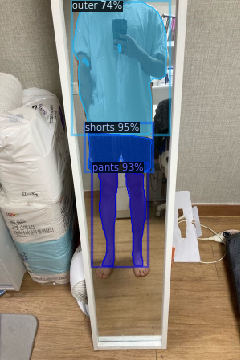

108 157 189 214
125.00014403470001


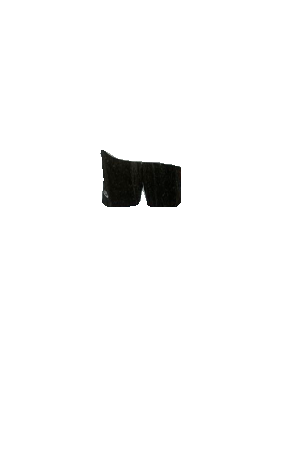

123 212 181 333
125.0


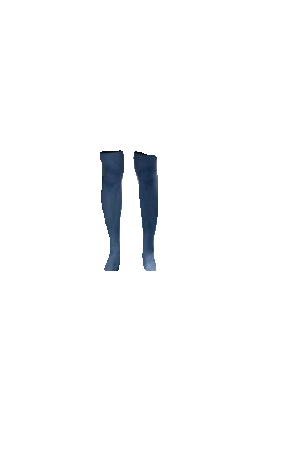

91 2 208 167
125.0


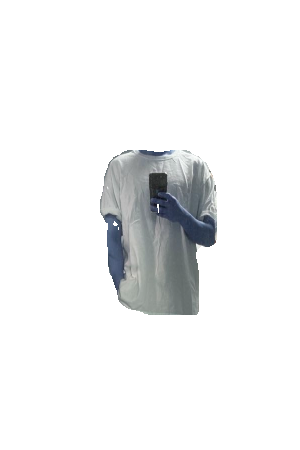

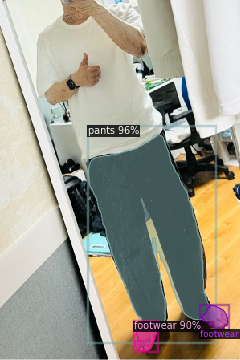

110 167 267 408
124.98392760669908


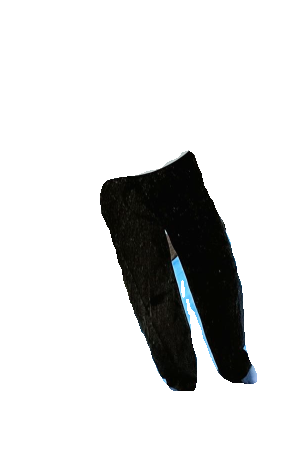

168 402 195 438
125.0


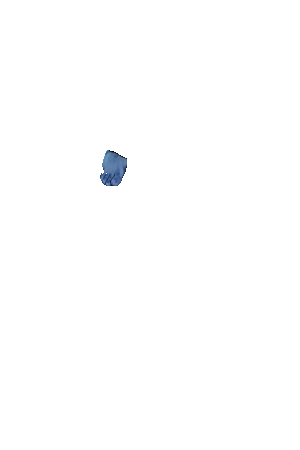

251 381 284 411
125.00008888910837


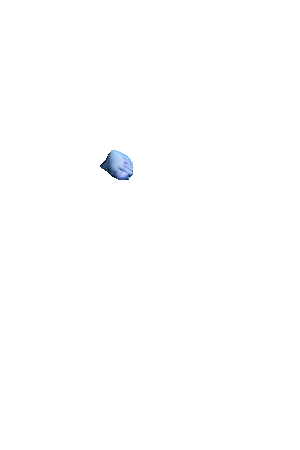

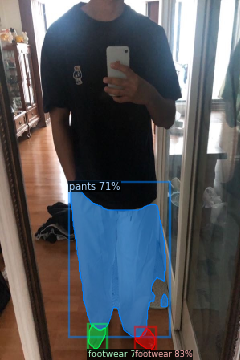

169 410 193 436
125.0


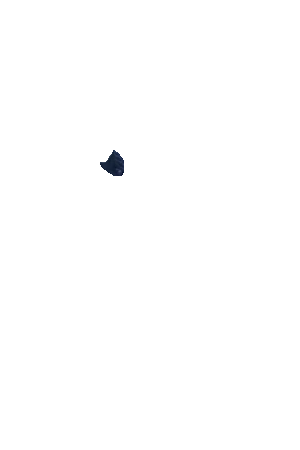

88 232 209 420
125.0


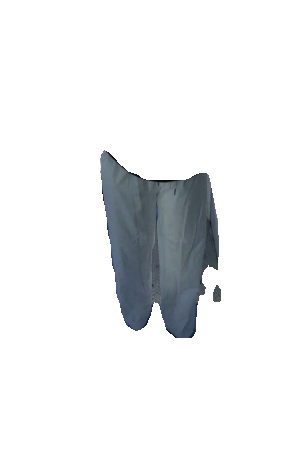

110 406 131 436
125.0


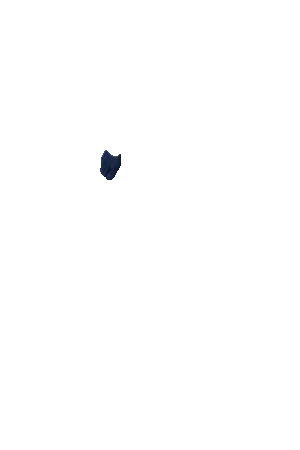

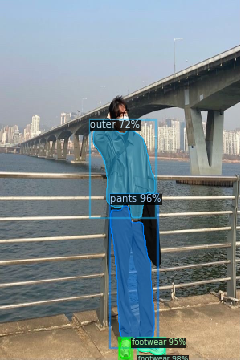

172 423 205 443
125.0


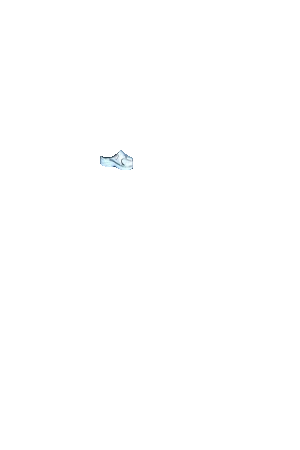

138 257 192 431
125.0


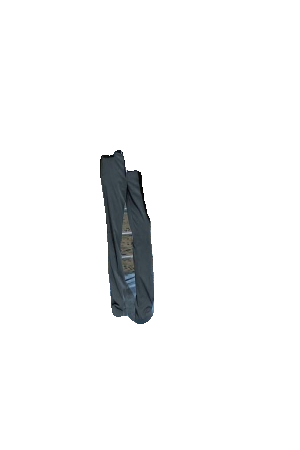

149 423 163 447
125.0


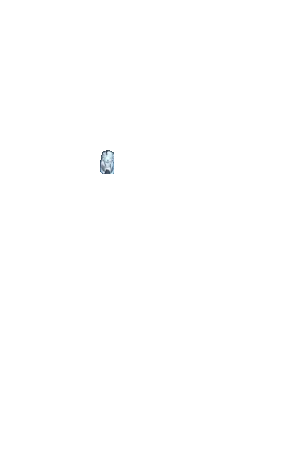

116 151 193 271
125.00003786036275


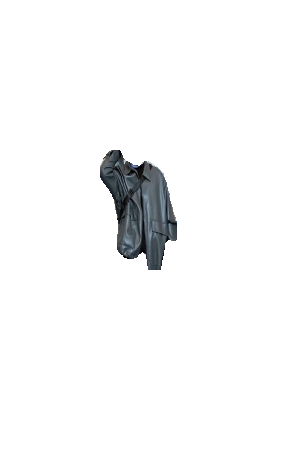

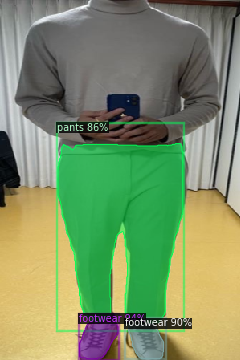

99 393 147 448
125.0


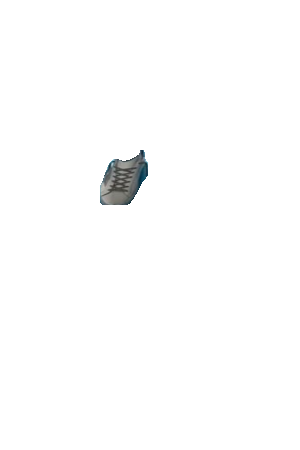

160 398 204 448
125.0


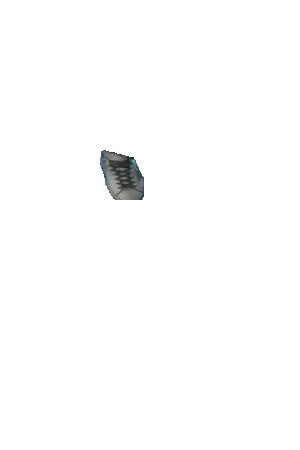

72 179 228 403
124.99991193372148


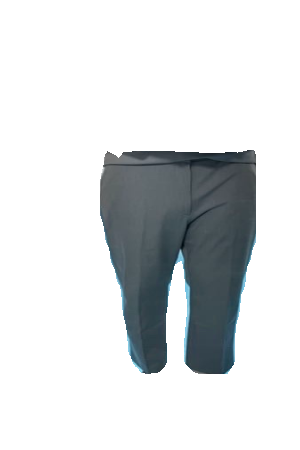

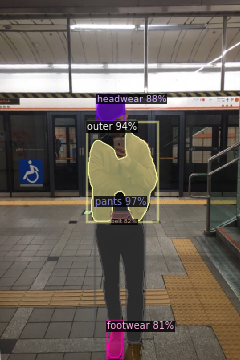

119 247 180 428
125.0


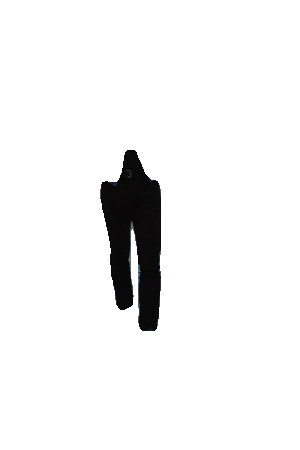

110 162 196 276
125.0


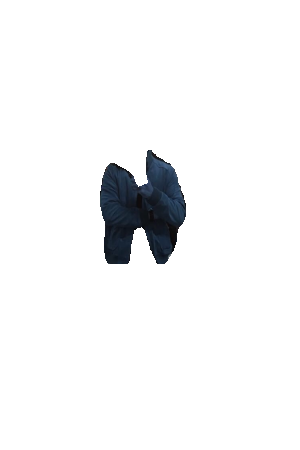

121 119 154 152
125.0


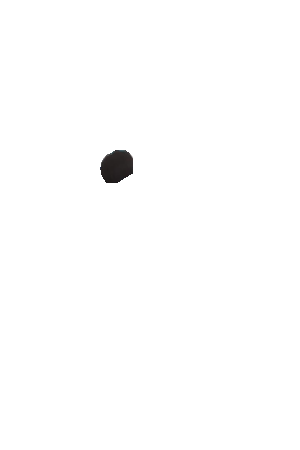

139 266 161 273
125.0


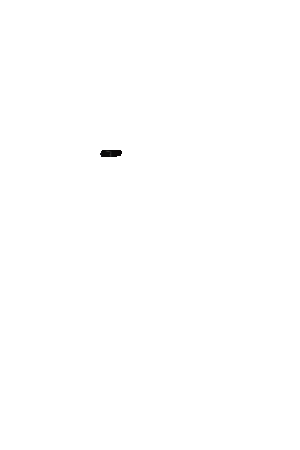

134 402 152 446
125.0


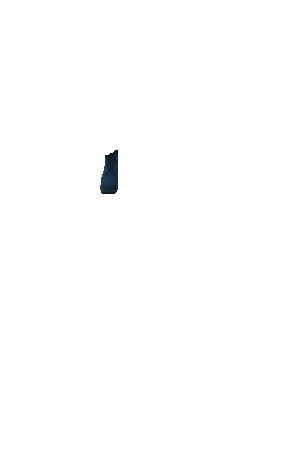

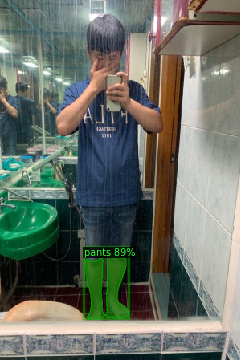

106 314 160 397
125.00070291189897


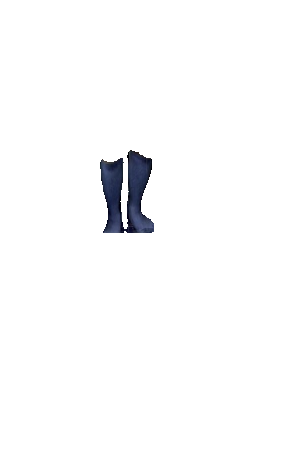

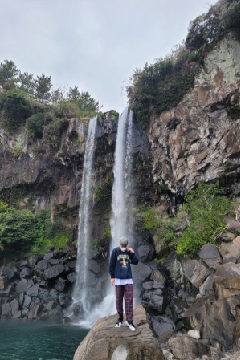

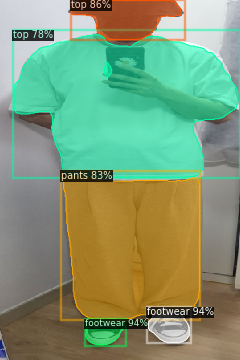

106 400 156 430
125.0


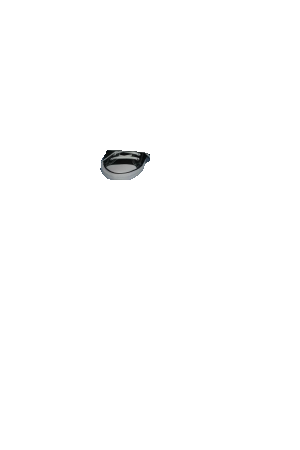

185 385 236 428
125.0


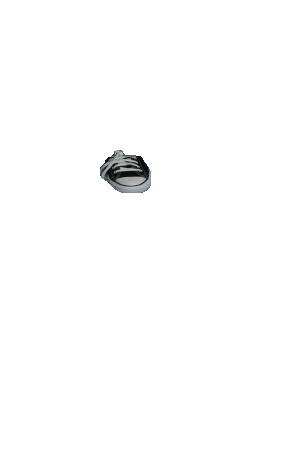

89 0 226 49
125.0


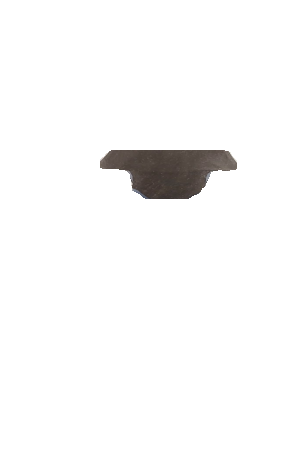

79 219 249 399
125.0


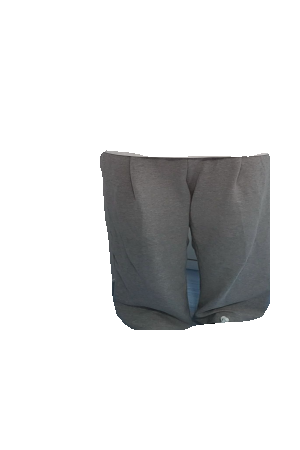

17 43 297 221
125.0


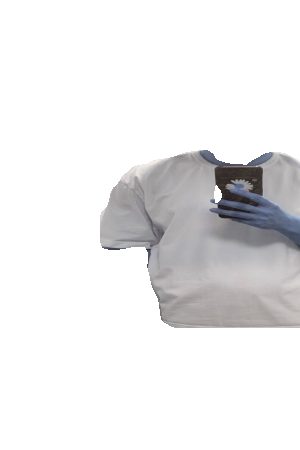

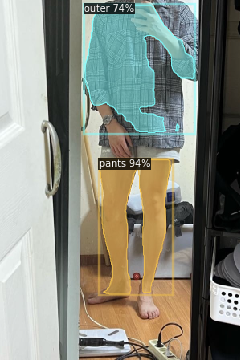

124 199 213 367
125.0


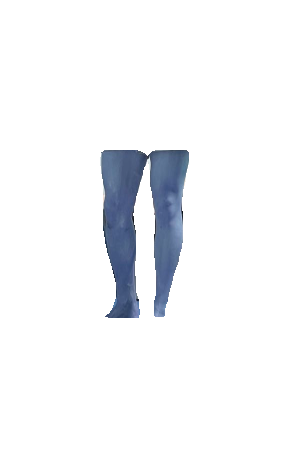

106 5 243 165
125.0


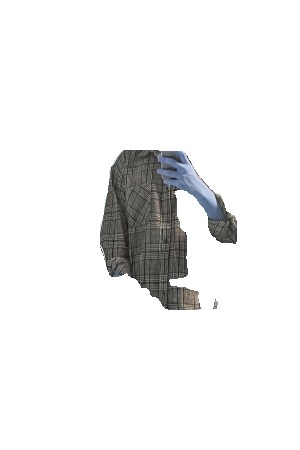

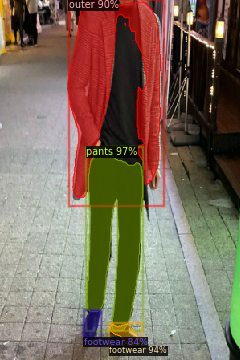

108 184 178 413
124.98663922936984


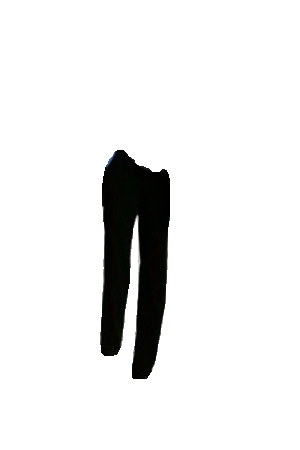

138 405 174 432
125.00248083607633


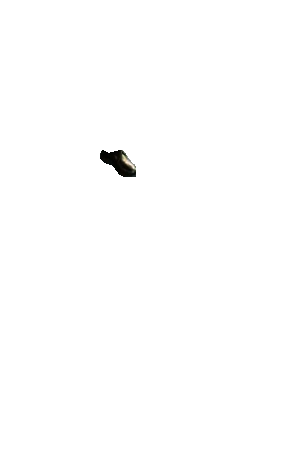

86 0 200 246
124.99737845194501


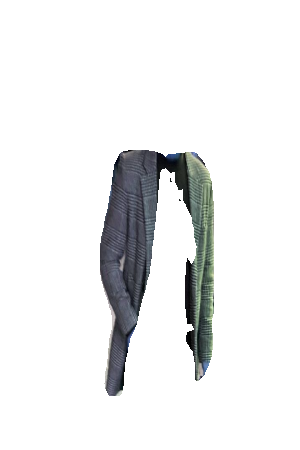

105 388 124 421
125.00315008202395


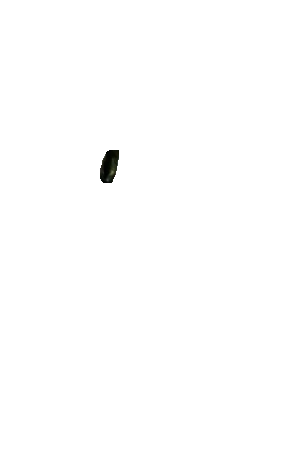

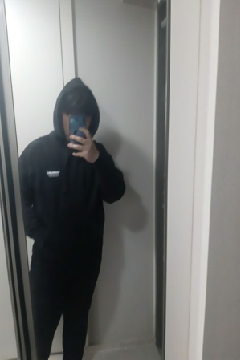

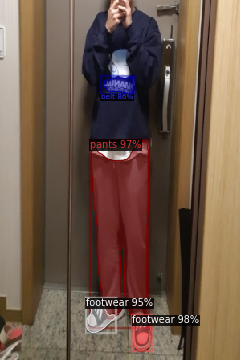

166 395 188 437
125.0


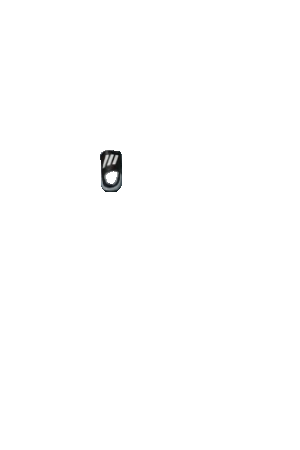

114 176 185 401
125.0


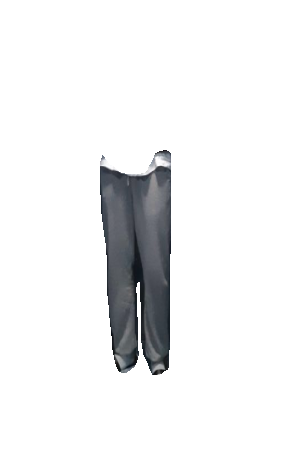

108 374 144 415
125.0


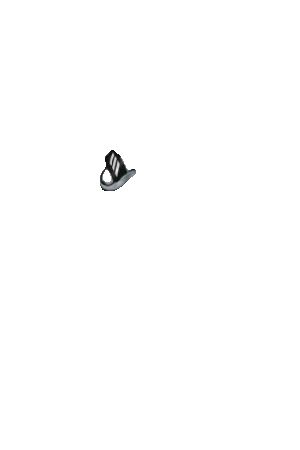

128 96 167 117
125.0


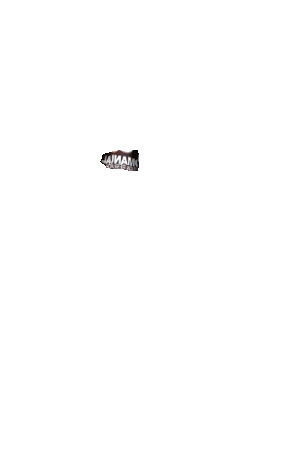

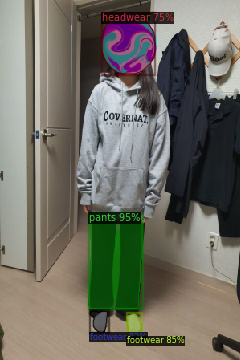

111 269 177 385
125.0


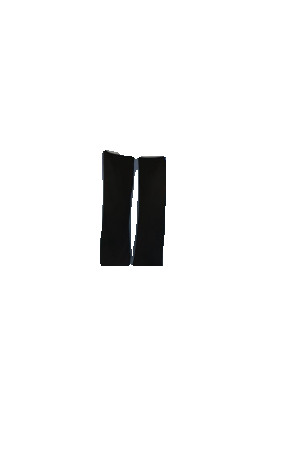

159 392 176 419
125.0


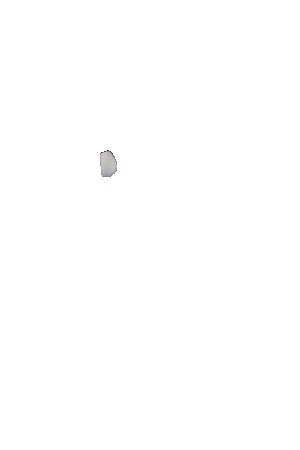

113 388 134 415
125.0


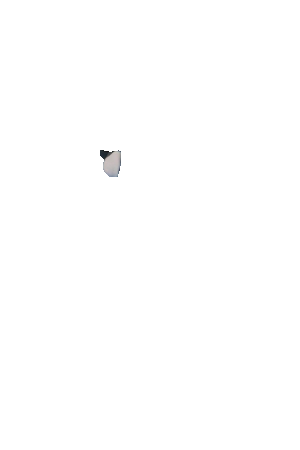

127 16 193 92
125.02318073956891


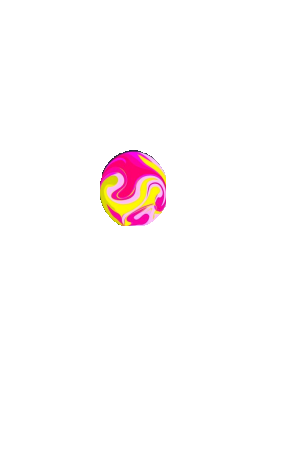

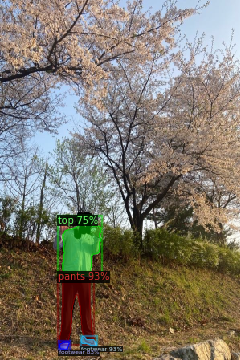

101 420 120 432
125.0


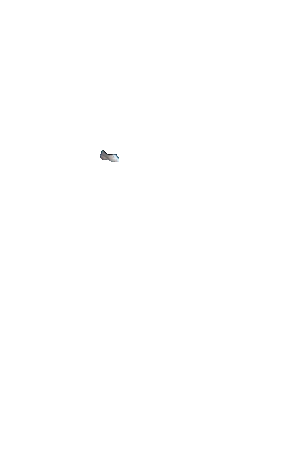

74 340 116 429
125.004486793186


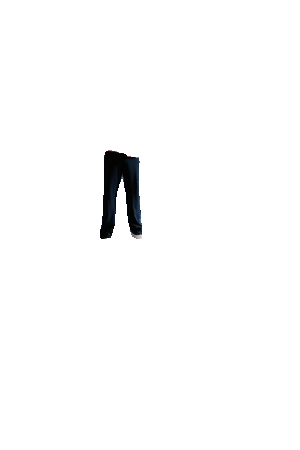

74 427 86 437
125.0


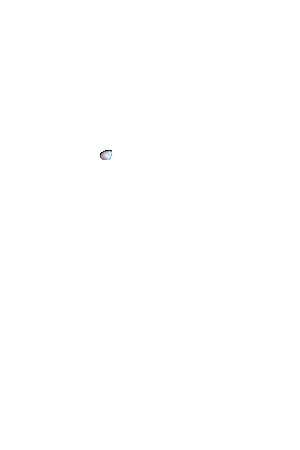

78 270 125 343
125.01138150733544


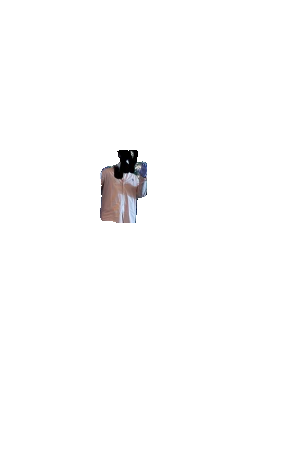

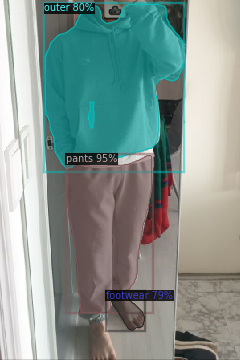

83 194 189 390
125.0


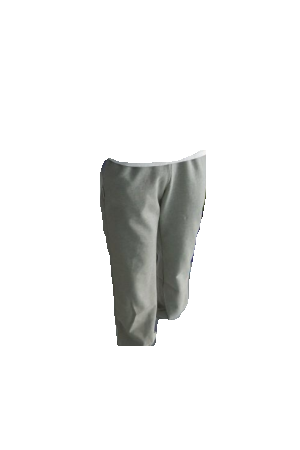

56 5 229 210
125.0


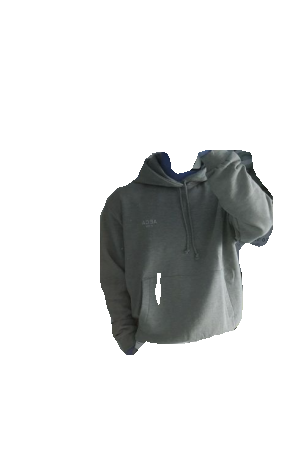

138 363 180 412
125.0


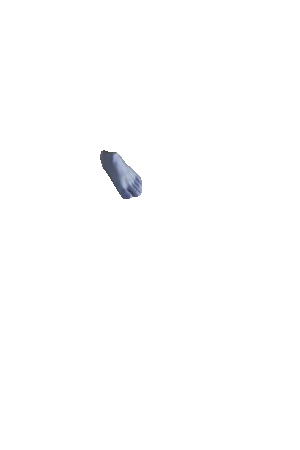

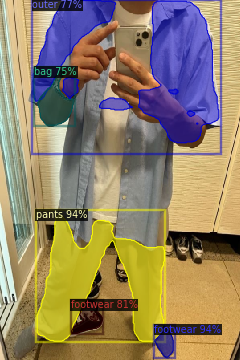

46 269 205 426
124.99995473195142


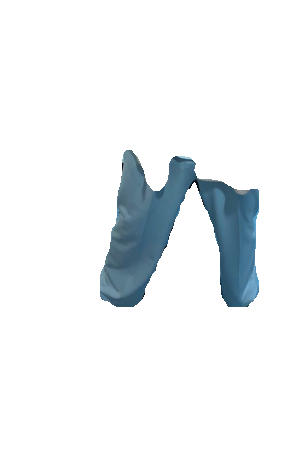

193 407 216 446
125.00008559691916


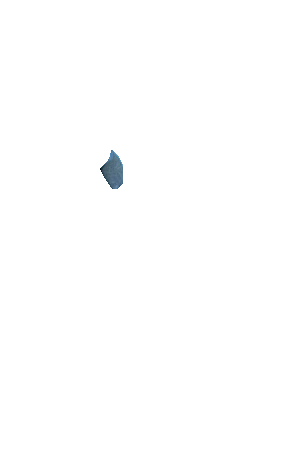

89 376 127 416
125.00570995314973


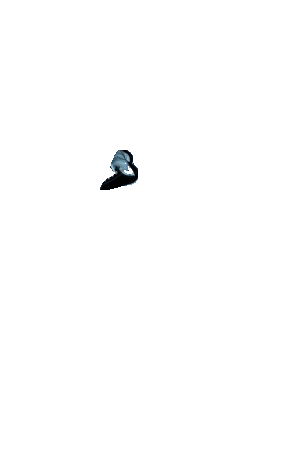

41 0 273 178
125.0


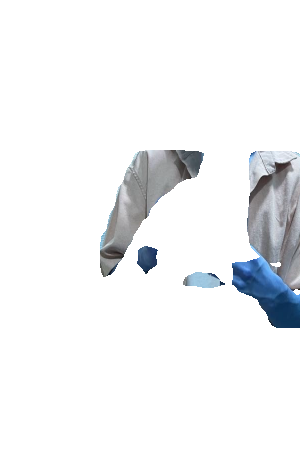

47 88 91 156
125.0


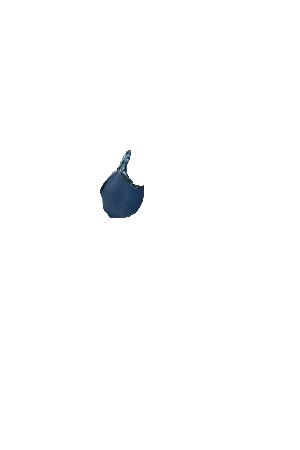

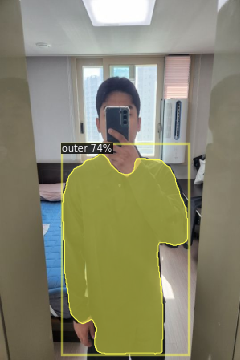

78 192 234 442
125.0


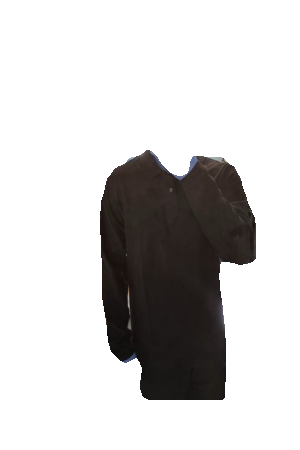

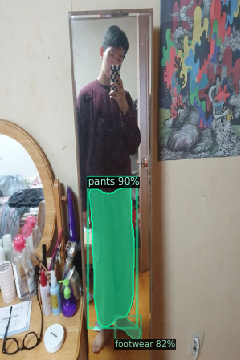

111 228 167 408
125.0


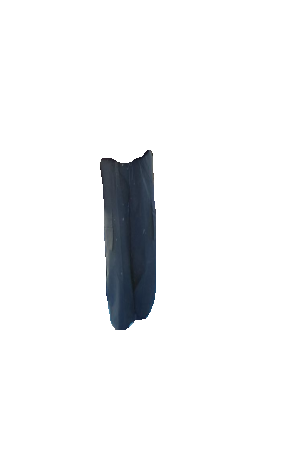

144 395 175 424
125.0


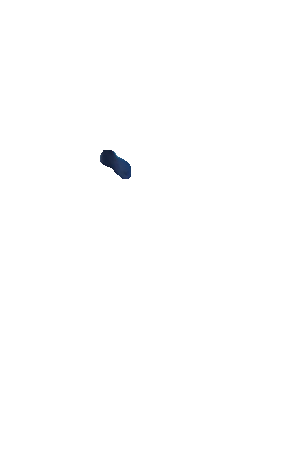

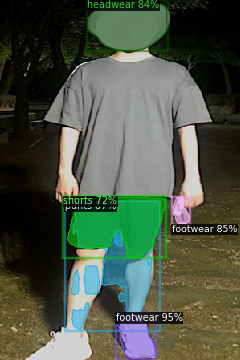

147 392 193 447
125.00052428760262


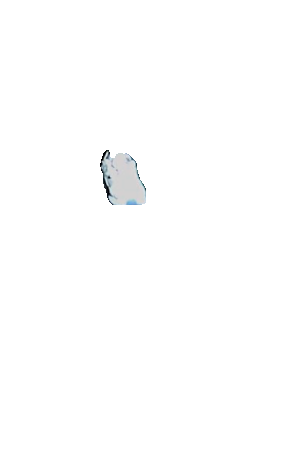

89 251 199 411
124.9998551325866


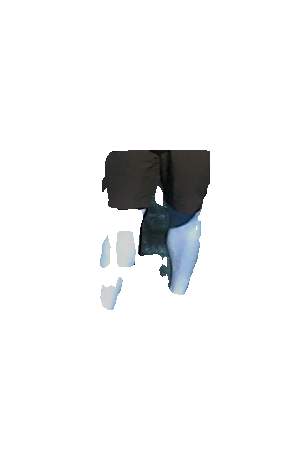

216 246 236 279
125.00007407425697


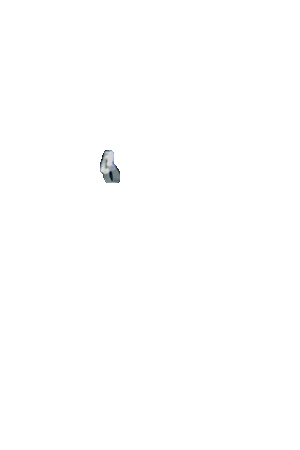

109 1 208 63
125.00003539103389


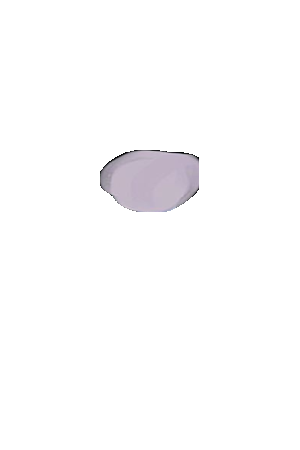

84 246 206 322
125.00055557887615


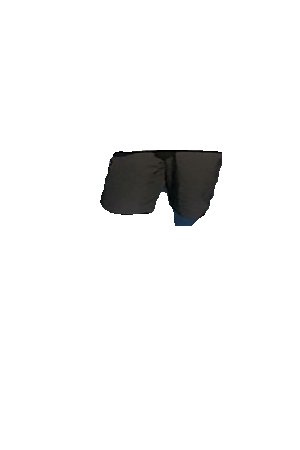

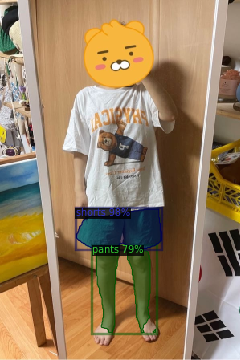

95 261 201 311
125.0


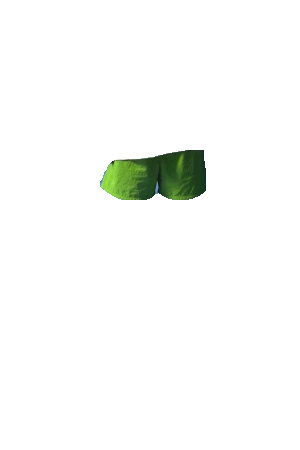

120 308 194 416
125.0


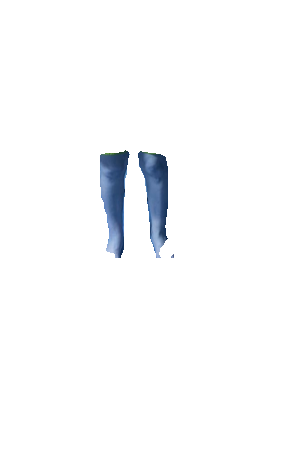

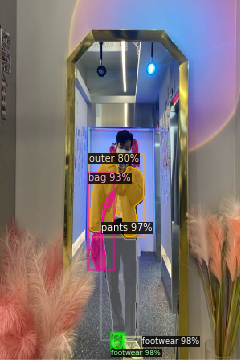

139 417 153 436
125.0


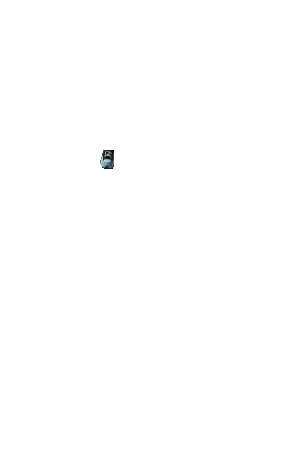

156 423 176 447
125.0


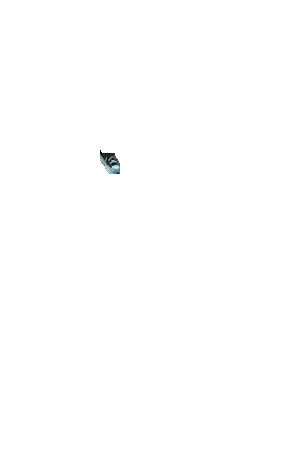

128 281 171 424
125.00523404616136


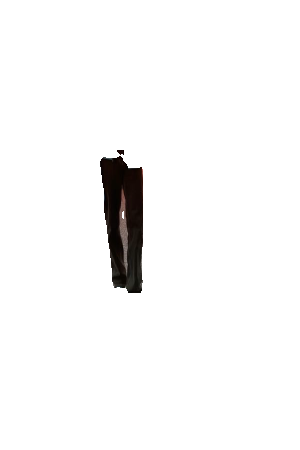

113 239 141 336
125.00006008245288


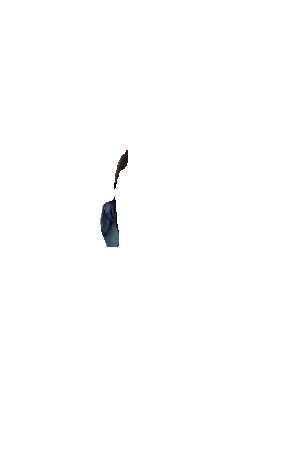

112 200 179 295
125.00016049580859


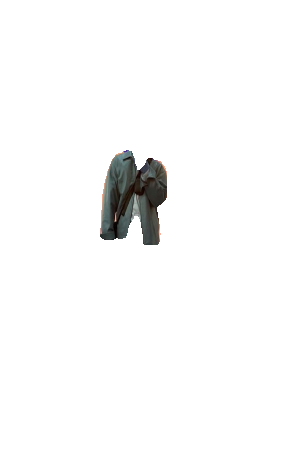

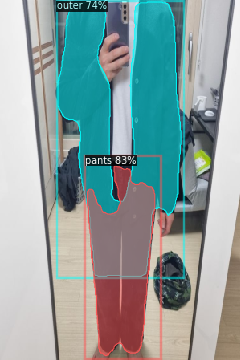

109 207 193 444
125.0


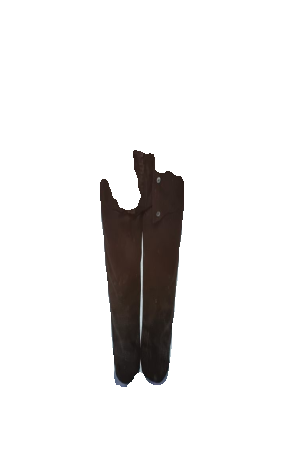

72 2 226 345
125.0


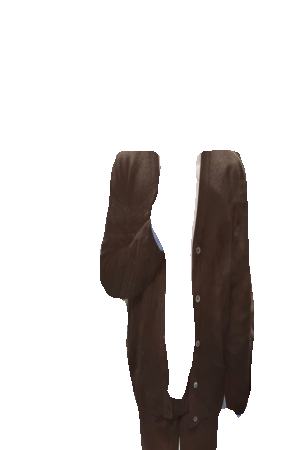

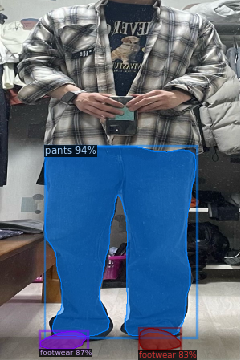

56 183 244 420
124.99993909404867


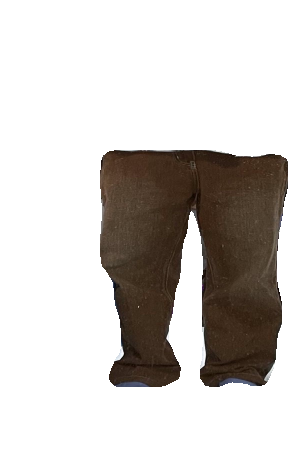

50 414 107 436
125.0


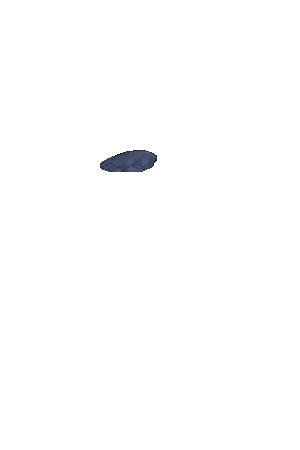

174 410 225 437
125.0


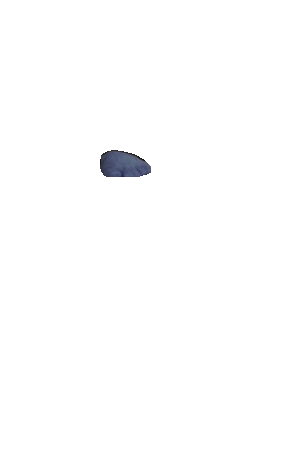

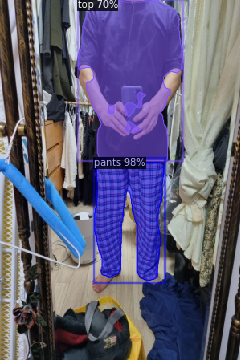

118 198 204 350
125.0


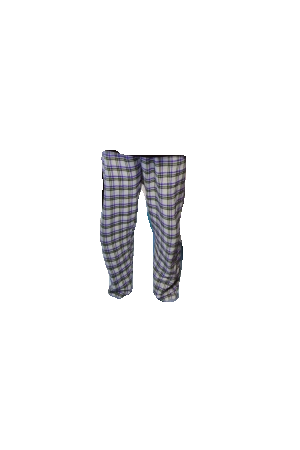

98 1 228 200
125.0


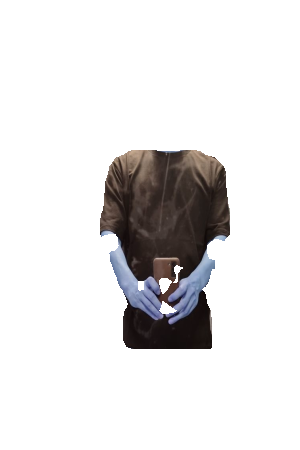

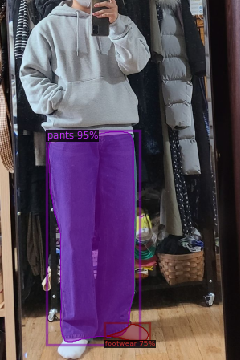

60 164 167 427
125.0


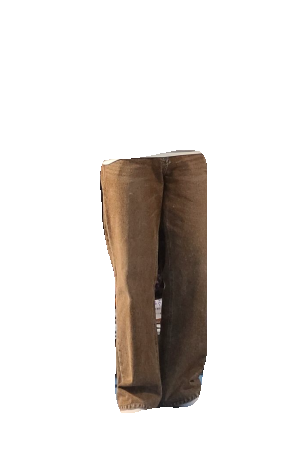

133 405 185 425
125.0


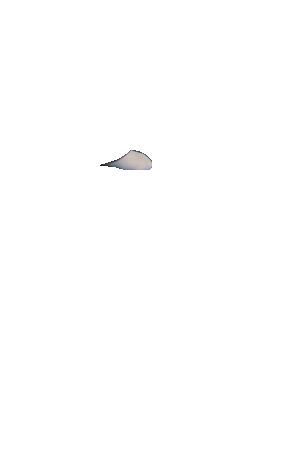

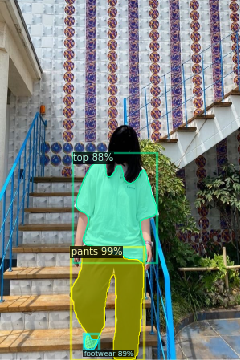

89 309 179 449
125.00508227284448


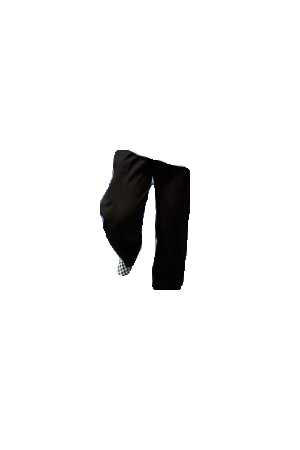

105 417 122 437
125.0


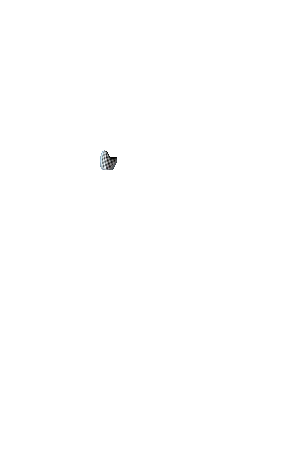

95 201 195 326
125.0


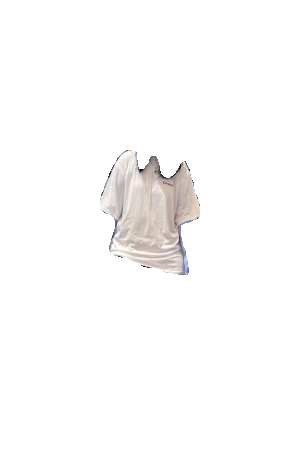

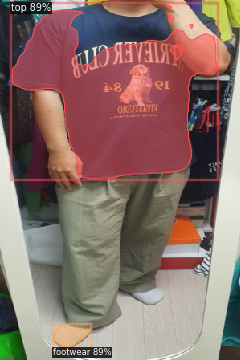

66 406 112 434
125.0


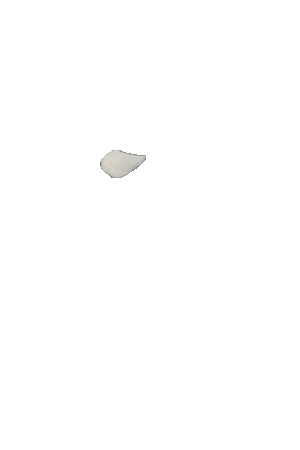

14 7 270 223
125.0


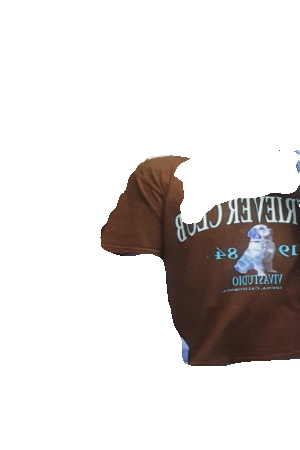

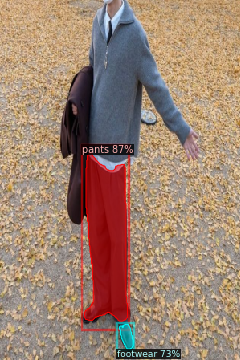

105 189 159 401
124.99982633659096


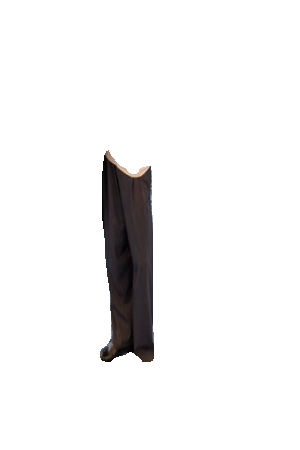

149 405 166 436
125.0


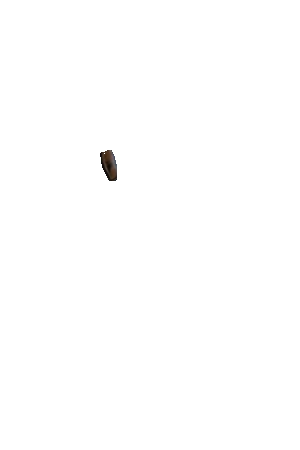

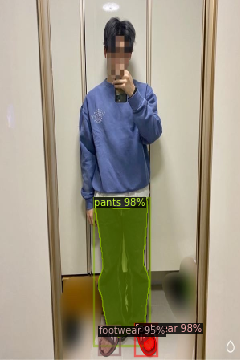

170 405 194 443
125.00013744923844


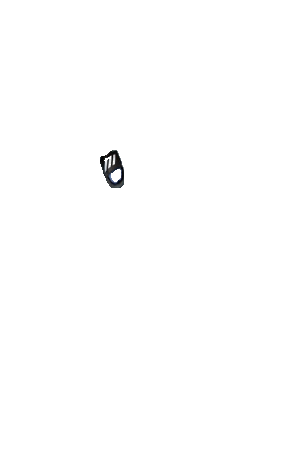

119 249 186 421
124.99920711374583


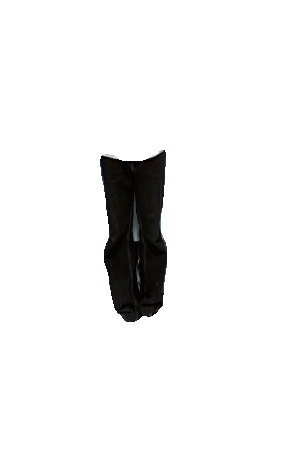

124 408 146 443
125.00027736830972


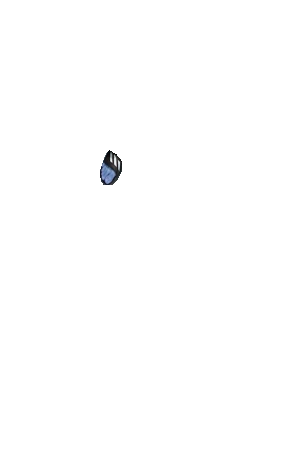

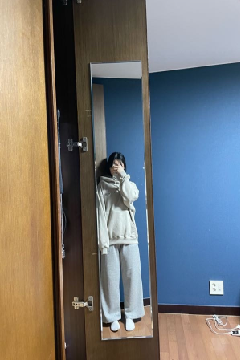

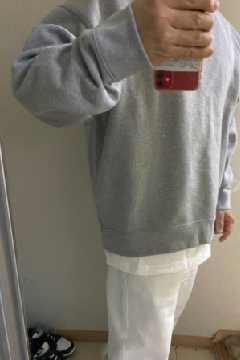

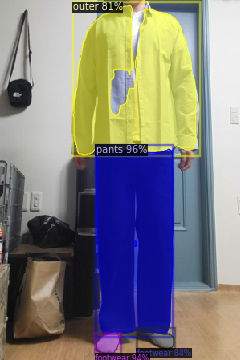

120 185 215 416
125.0


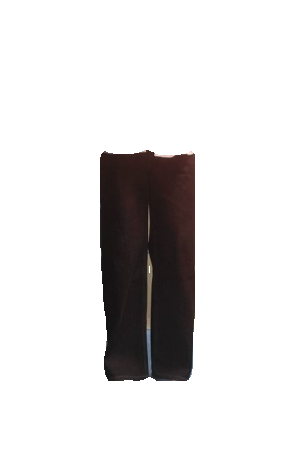

120 417 149 441
125.0


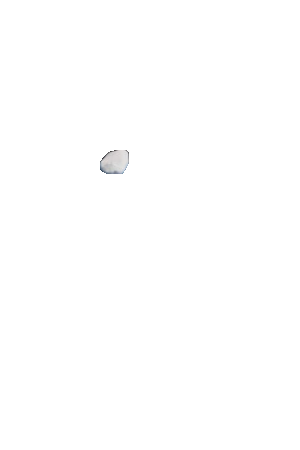

172 411 217 435
125.0


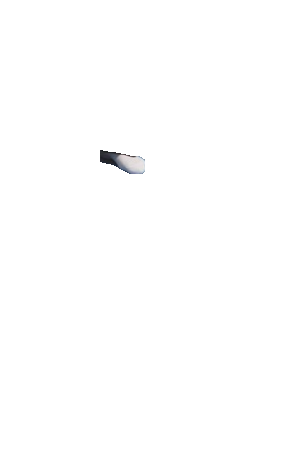

91 6 245 193
125.0


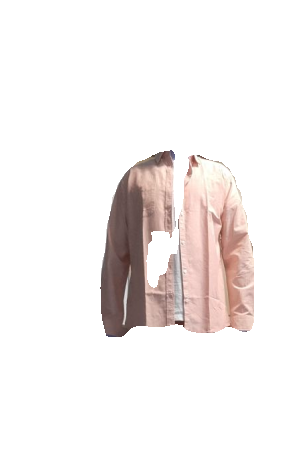

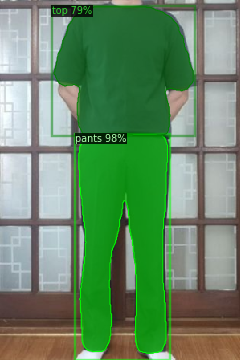

98 167 209 441
125.0


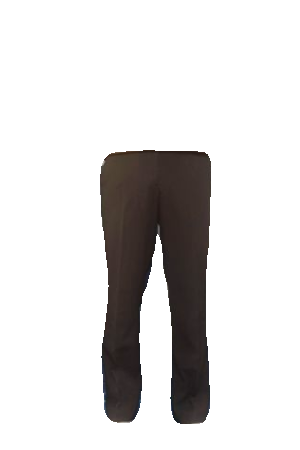

67 8 241 169
125.0


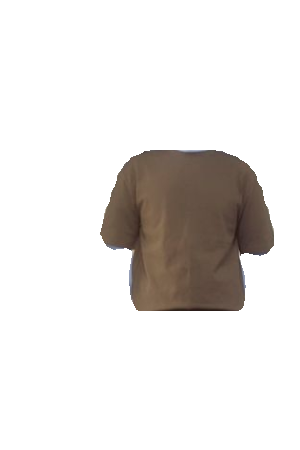

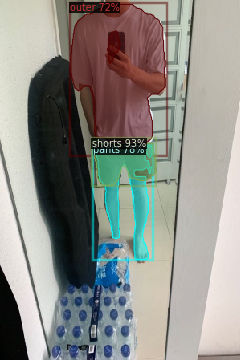

115 175 194 231
125.0


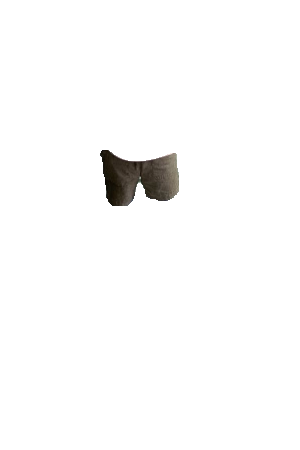

118 181 190 324
125.0


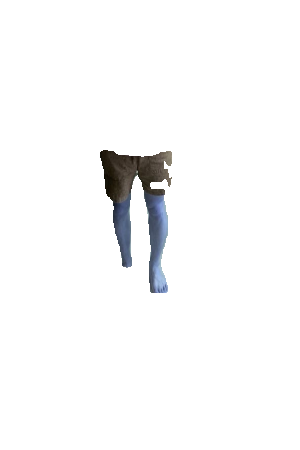

88 5 206 182
125.0


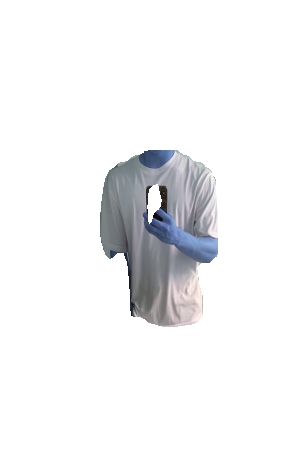

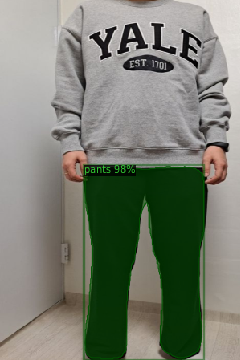

106 208 254 448
125.01200456061265


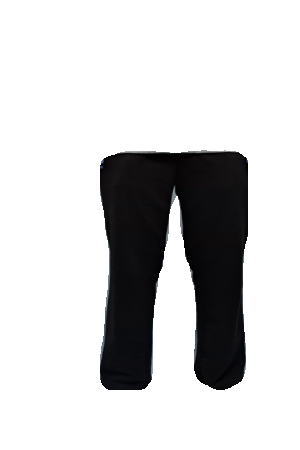

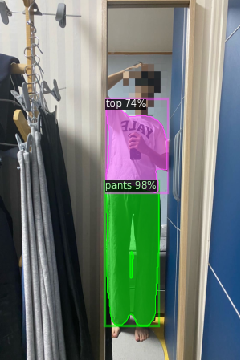

132 227 198 407
125.0


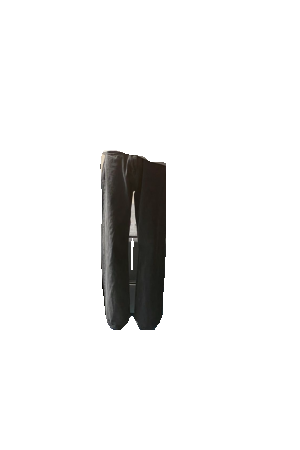

132 125 208 240
125.0


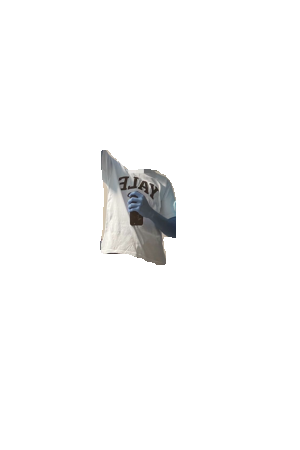

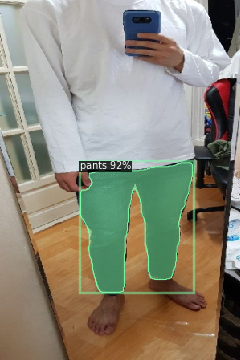

100 203 240 365
124.99854809078877


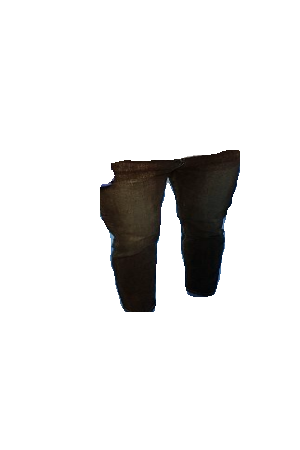

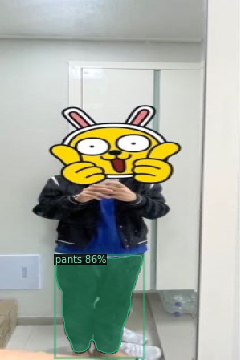

69 319 178 441
125.00038437163057


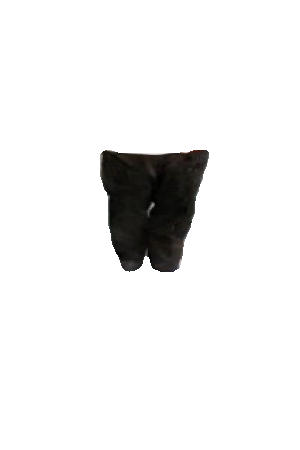

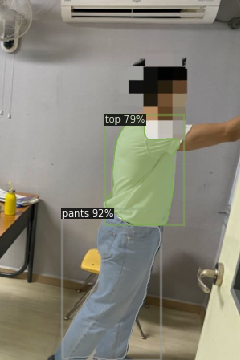

78 265 200 449
125.0


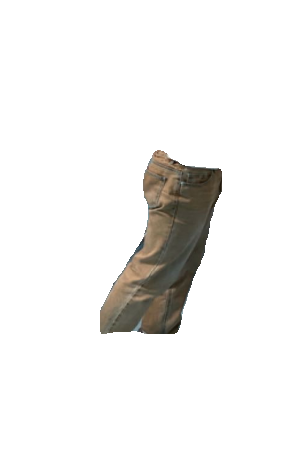

131 144 224 280
125.0


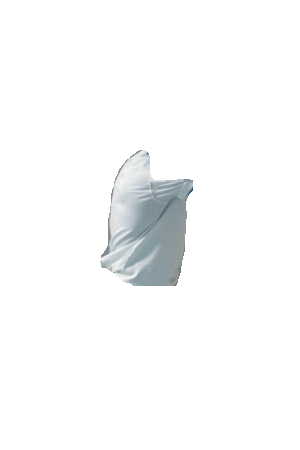

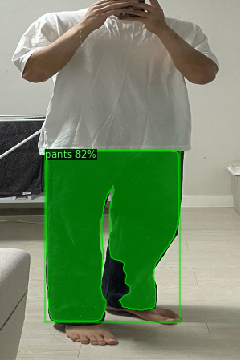

57 188 223 401
124.98136367494847


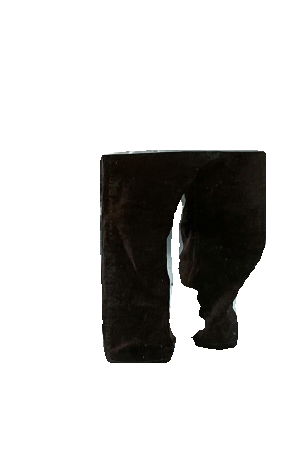

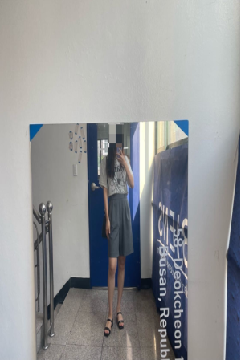

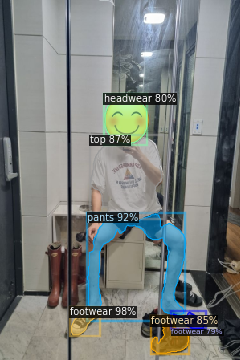

89 384 123 418
125.0


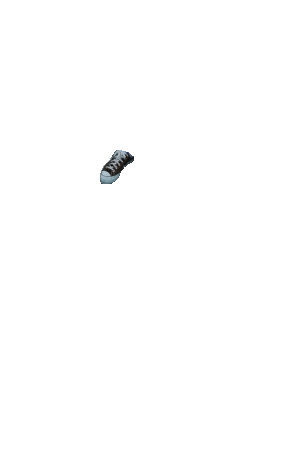

109 267 231 393
125.0


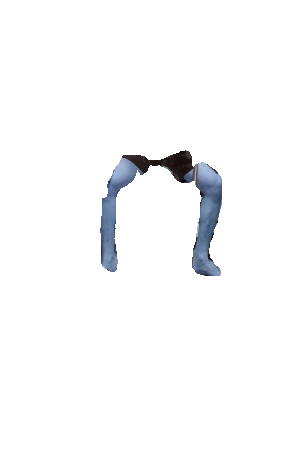

113 172 202 272
125.0


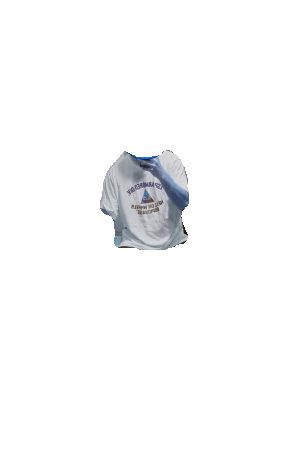

189 395 235 441
125.0


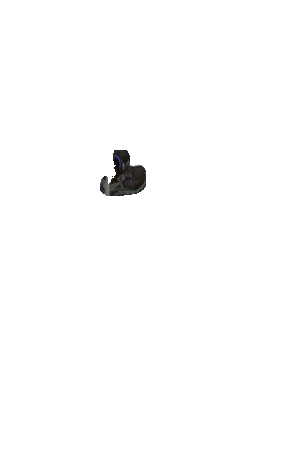

131 119 183 180
125.0005028918338


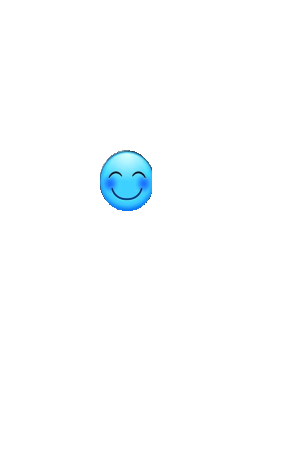

216 390 255 410
125.0


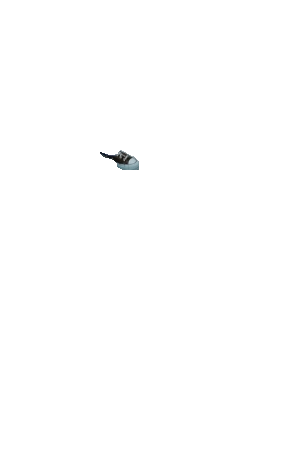

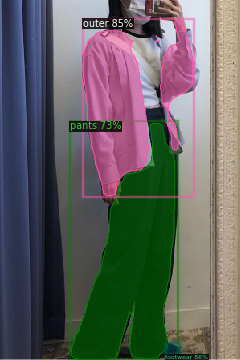

207 429 224 442
125.00009218129756


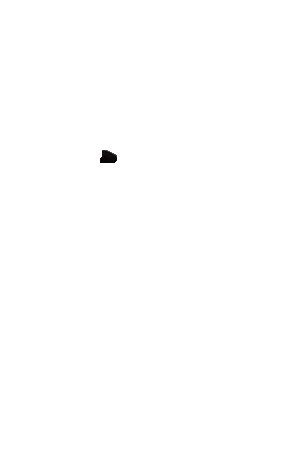

104 26 240 244
125.0


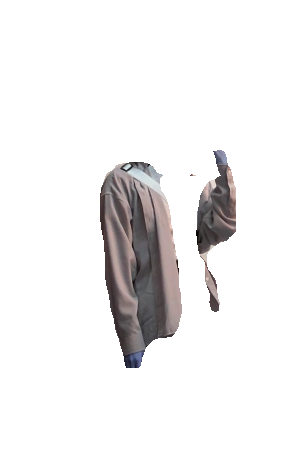

89 154 218 449
124.98026738337796


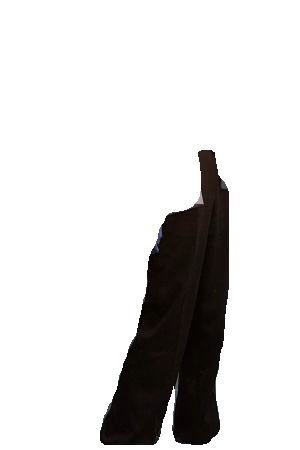

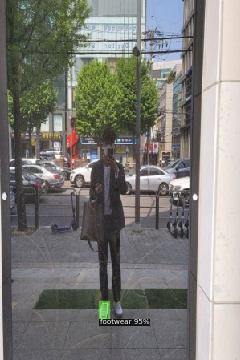

125 378 135 398
125.0


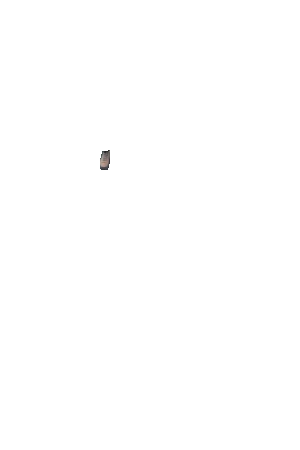

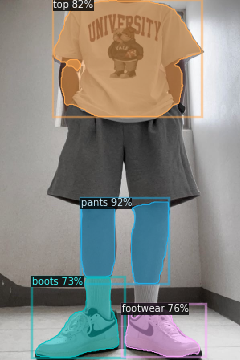

101 252 211 354
125.0


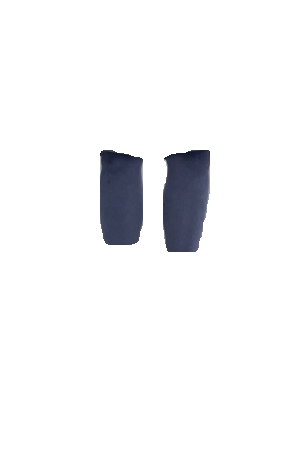

67 0 250 145
125.0


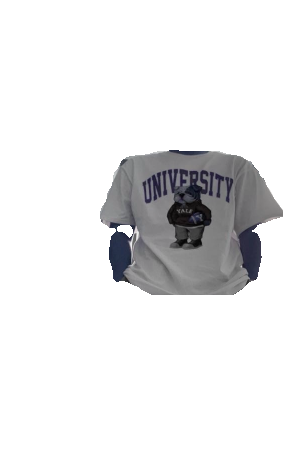

156 380 249 445
125.0


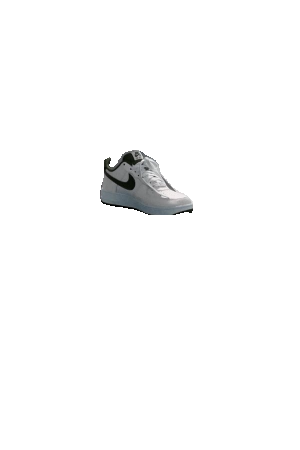

44 347 148 446
125.0


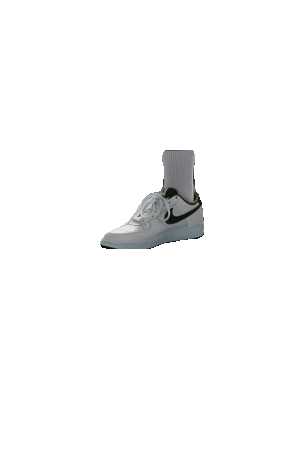

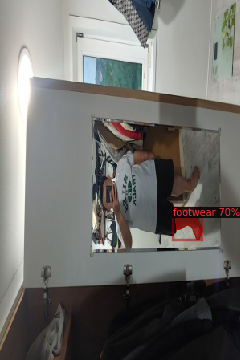

217 260 251 299
125.0


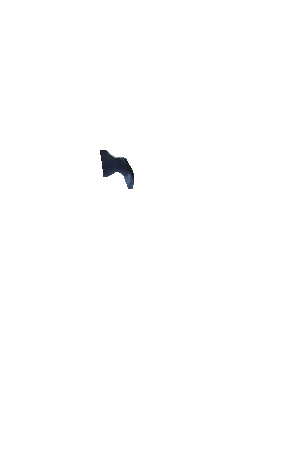

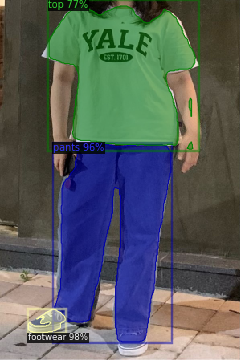

35 386 81 416
125.0


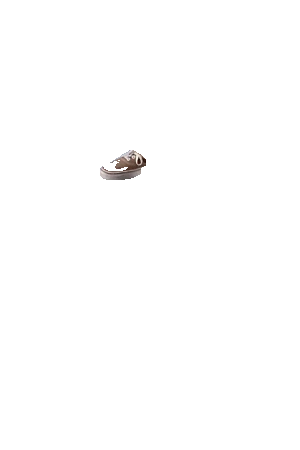

67 179 213 427
125.00007654377687


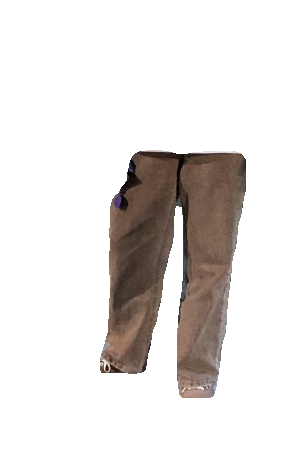

61 7 244 186
125.0


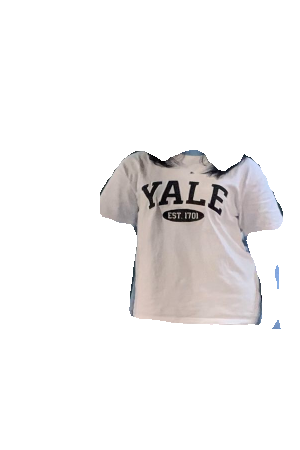

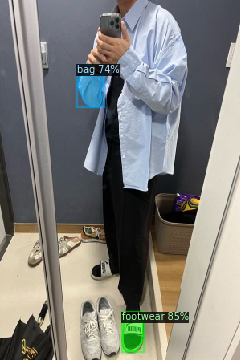

153 396 178 439
125.0


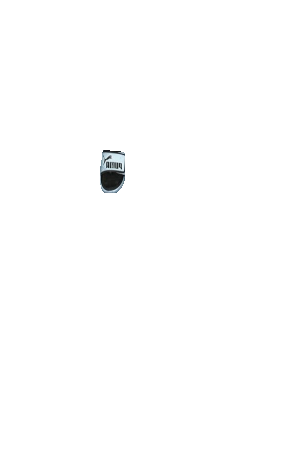

97 82 129 133
125.0


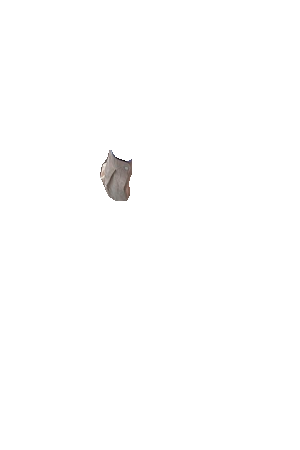

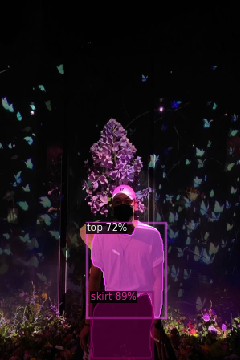

114 366 190 447
125.015141180386


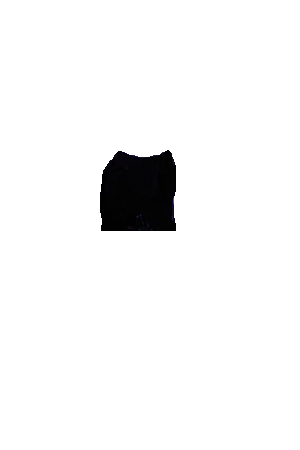

114 281 204 396
125.0001399232233


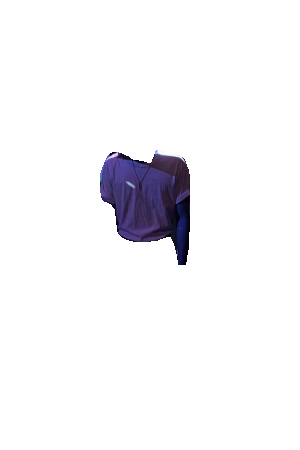

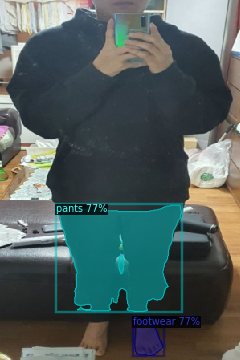

167 397 203 444
125.0


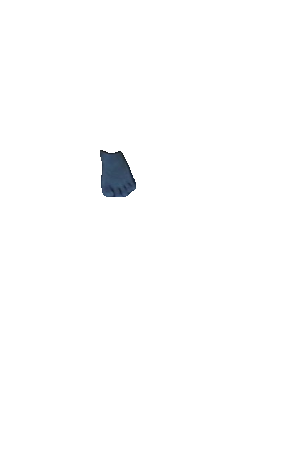

71 256 226 389
125.0


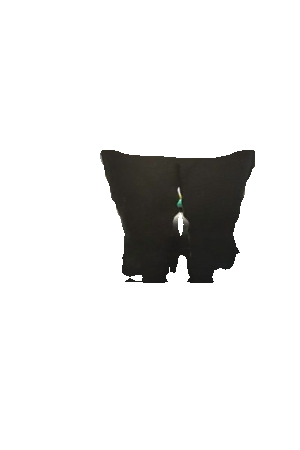

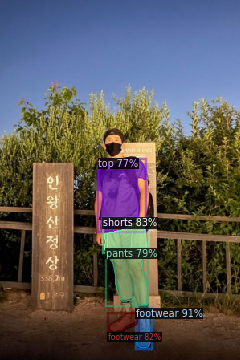

170 387 188 434
125.00052840549937


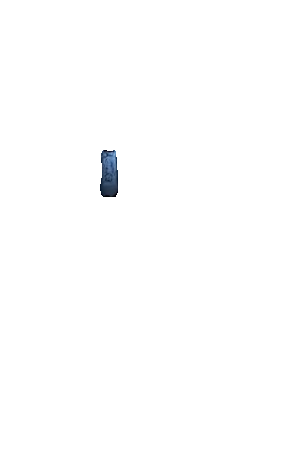

130 274 184 314
125.0


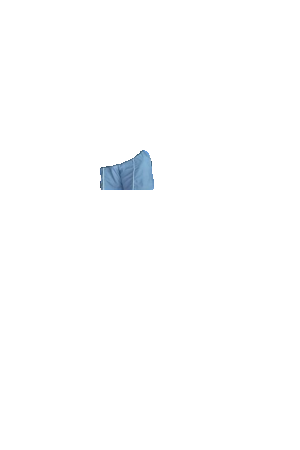

136 391 171 414
125.00076874515933


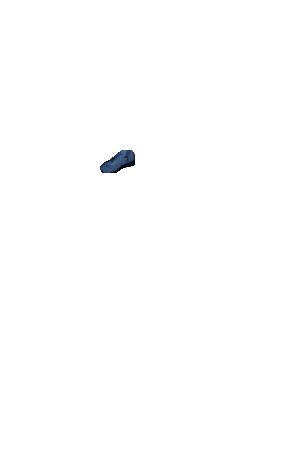

134 313 184 381
125.00020740996803


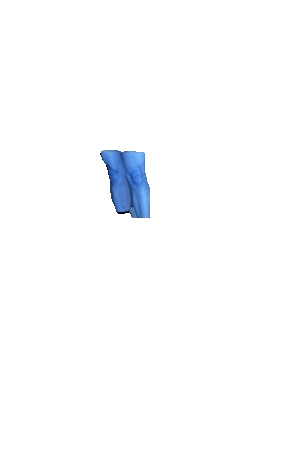

123 199 181 289
125.00053663611462


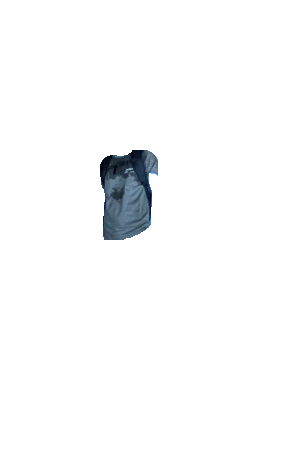

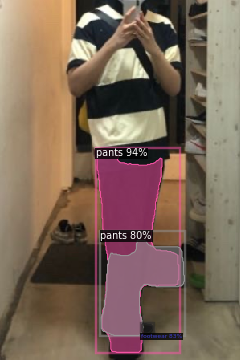

121 186 223 440
124.99996460896611


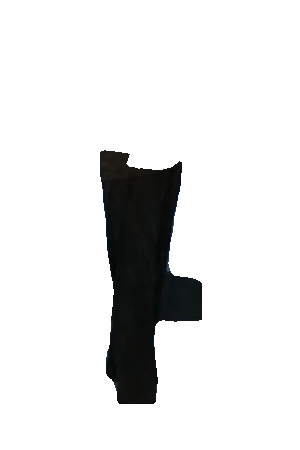

177 404 190 416
125.0


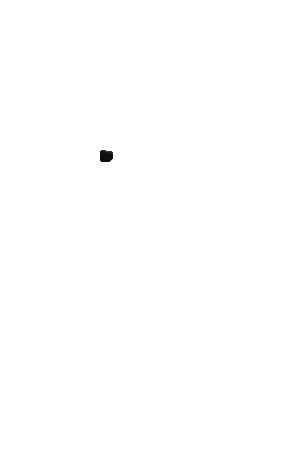

126 300 230 419
125.0


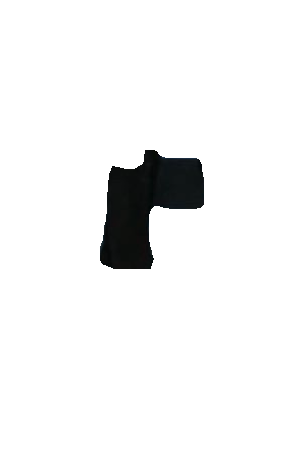

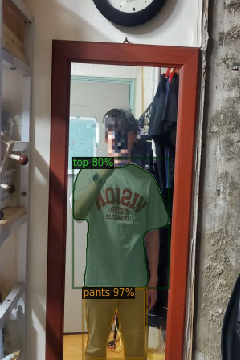

106 360 181 448
125.0


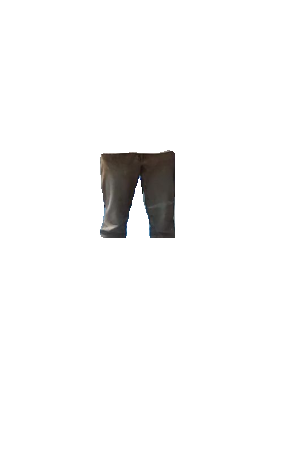

91 204 210 359
125.0


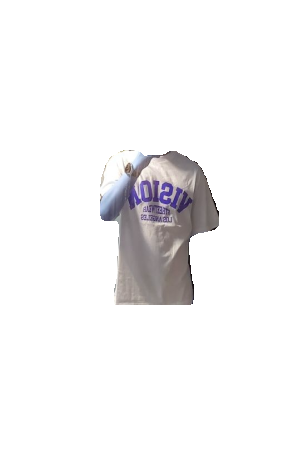

In [ ]:
from skimage import io

# insert your url
a = os.listdir('/content/drive/MyDrive/001')
for j in a:
  i = io.imread(j)
  i = cv2.resize(i, dsize=(300, 450), interpolation=cv2.INTER_AREA)

  out = predictor(i)
  v = Visualizer(i[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
      )
  v = v.draw_instance_predictions(out["instances"].to("cpu"))
  cv2_imshow(v.get_image()[:, :, ::])


  # crop img
  from re import I
  from PIL import Image

  masks = np.asarray(out["instances"].pred_masks.to("cpu"))

  for j in range(masks.shape[0]):
    item_mask = masks[j]

    segmentation = np.where(item_mask == True)
    x_min = int(np.min(segmentation[1]))
    x_max = int(np.max(segmentation[1]))
    y_min = int(np.min(segmentation[0]))
    y_max = int(np.max(segmentation[0]))
    print(x_min, y_min,x_max, y_max)

    cropped = Image.fromarray(i[y_min:y_max, x_min:x_max, :], mode='RGB')

    mask = Image.fromarray((item_mask * 255).astype('uint8'))


    cropped_mask = mask.crop((x_min, y_min, x_max, y_max))
    bg = np.full((450, 300, 3), 255, np.uint8) # 흰색배경
    # bg = np.zeros((450, 300, 3), np.uint8) # 검정색 배경
    background = Image.fromarray(bg, mode='RGB')
    paste_position = (100,150)

    new_fg_image = Image.new('RGB', background.size)
    new_fg_image.paste(cropped, paste_position)

    new_alpha_mask = Image.new("L", background.size, color = 0)
    new_alpha_mask.paste(cropped_mask, paste_position)

    composite = Image.composite(new_fg_image, background, new_alpha_mask)


    composite_array = np.array(composite)
    nonzero_composite_array = np.nonzero(composite_array)
    np_av = np.average(nonzero_composite_array)
    print(np_av)
  


    cv2_imshow(np.array(composite))
    item_num = out['instances'].pred_classes[j].item()
    if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
      cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
    elif item_num == 7 or item_num == 10:
      cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
    else:
      cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))

In [ ]:
from skimage import io

# insert your url
i = io.imread('/content/drive/MyDrive/001/14_1549284_0.jpg')
i = cv2.resize(i, dsize=(300, 450), interpolation=cv2.INTER_AREA)

out = predictor(i)
v = Visualizer(i[:, :, ::-1],
                metadata=moda_metadata, 
                scale=0.8
                # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
v = v.draw_instance_predictions(out["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::])


# crop img
from re import I
from PIL import Image

masks = np.asarray(out["instances"].pred_masks.to("cpu"))

top_dict = {}
bot_dict = {}


for j in range(masks.shape[0]):
  item_mask = masks[j]

  segmentation = np.where(item_mask == True)
  x_min = int(np.min(segmentation[1]))
  x_max = int(np.max(segmentation[1]))
  y_min = int(np.min(segmentation[0]))
  y_max = int(np.max(segmentation[0]))
  # print(x_min, y_min,x_max, y_max)

  cropped = Image.fromarray(i[y_min:y_max, x_min:x_max, :], mode='RGB')

  mask = Image.fromarray((item_mask * 255).astype('uint8'))


  cropped_mask = mask.crop((x_min, y_min, x_max, y_max))
  bg = np.full((450, 300, 3), 255, np.uint8) # 흰색배경
  # bg = np.zeros((450, 300, 3), np.uint8) # 검정색 배경
  background = Image.fromarray(bg, mode='RGB')
  paste_position = (100,150)

  new_fg_image = Image.new('RGB', background.size)
  new_fg_image.paste(cropped, paste_position)

  new_alpha_mask = Image.new("L", background.size, color = 0)
  new_alpha_mask.paste(cropped_mask, paste_position)

  composite = Image.composite(new_fg_image, background, new_alpha_mask)


  composite_array = np.array(composite)
  nonzero_composite_array = np.nonzero(composite_array)
  np_av = np.average(nonzero_composite_array)
  print(np_av)
 




  cv2.imshow(np.array(composite))
  item_num = out['instances'].pred_classes[j].item()
  if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:     # 4:outer, 5:dress, 8: top, 9: shorts
      if item_num == 4:
        top_dict["outer"] = np.array(composite)[:,:,::-1]
      elif item_num == 5:
        top_dict["dress"] = np.array(composite)[:,:,::-1]
      elif item_num == 8:
        top_dict["top"] = np.array(composite)[:,:,::-1]      
      else:
        top_dict["shorts"] = np.array(composite)[:,:,::-1]
      #cv2.imwrite(f"data/images_output/top/top{j}.jpg",   
    #np.array(composite)[:,:,::-1])
      #print(f"data/images_output/top/top{j}.jpg")
  elif item_num == 7 or item_num == 10:     #   
      if item_num == 7:
        bot_dict["pants"] = np.array(composite)[:,:,::-1]
      else:
        bot_dict["skirt"] = np.array(composite)[:,:,::-1]
    #   cv2.imwrite(f"data/images_output/bottom/bottom{j}.jpg", 
    # np.array(composite)[:,:,::-1])
    #   print(f"data/images_output/bottom/bottom{j}.jpg")
# return top_dict, bot_dict

fine tuning try1

In [ ]:
# import 
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# coco 데이터셋에 cloth 객체instance를 추가해준다.
from detectron2.data.datasets import register_coco_instances
#register_coco_instances("modatrain_2", {}, "/content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json", "/content/drive/MyDrive/modanet/datasets/coco/images")
cloth_metadata = MetadataCatalog.get("modatrain_2")
dataset_dicts = DatasetCatalog.get("modatrain_2")

# Now, let's fine-tune a coco-pretrained R50-FPN Mask R-CNN model on the cloth dataset. It takes ~6 minutes to train 300 iterations on Colab's K80 GPU.
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
# cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.merge_from_file("/content/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("cloth",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
# cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl"  # initialize from model zoo

cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.002
cfg.SOLVER.MAX_ITER = 300    # 300이 좋아보임
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 640 
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13  #  13개 클래스

os.makedirs('/content/drive/MyDrive/MODANETOUTPUT', exist_ok=True)
trainer = DefaultTrainer(cfg)
#trainer.resume_or_load(resume=False)
trainer.resume_or_load(resume=True)
trainer.train()

#Now, we perform inference with the trained model on the cloth dataset. First, let's create a predictor using the model we just trained:
cfg.MODEL.WEIGHTS = os.path.join('/content/drive/MyDrive/MODANETOUTPUT', "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # set the testing threshold for this model
cfg.DATASETS.TEST = ("cloth", )
predictor = DefaultPredictor(cfg)

#predict from url
from skimage import io

# insert your url
i = io.imread('/content/drive/MyDrive/001/16_1129745_0.jpg')
i = cv2.resize(i, dsize=(300, 450), interpolation=cv2.INTER_AREA)

out = predictor(i)
v = Visualizer(i[:, :, ::-1],
                metadata=cloth_metadata, 
                scale=0.8
                # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
v = v.draw_instance_predictions(out["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::])


# crop img
from re import I
from PIL import Image

masks = np.asarray(out["instances"].pred_masks.to("cpu"))

for j in range(masks.shape[0]):
  item_mask = masks[j]

  segmentation = np.where(item_mask == True)
  x_min = int(np.min(segmentation[1]))
  x_max = int(np.max(segmentation[1]))
  y_min = int(np.min(segmentation[0]))
  y_max = int(np.max(segmentation[0]))
  # print(x_min, y_min,x_max, y_max)

  cropped = Image.fromarray(i[y_min:y_max, x_min:x_max, :], mode='RGB')

  mask = Image.fromarray((item_mask * 255).astype('uint8'))


  cropped_mask = mask.crop((x_min, y_min, x_max, y_max))
  bg = np.full((450, 300, 3), 255, np.uint8) # 흰색배경
  # bg = np.zeros((450, 300, 3), np.uint8) # 검정색 배경
  background = Image.fromarray(bg, mode='RGB')
  paste_position = (100,150)

  new_fg_image = Image.new('RGB', background.size)
  new_fg_image.paste(cropped, paste_position)

  new_alpha_mask = Image.new("L", background.size, color = 0)
  new_alpha_mask.paste(cropped_mask, paste_position)

  composite = Image.composite(new_fg_image, background, new_alpha_mask)


  composite_array = np.array(composite)
  nonzero_composite_array = np.nonzero(composite_array)
  np_av = np.average(nonzero_composite_array)
  print(np_av)
 


  cv2_imshow(np.array(composite))
  item_num = out['instances'].pred_classes[j].item()
  if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
    cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
  elif item_num == 7 or item_num == 10:
    cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
  else:
    cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))


ModuleNotFoundError: ignored

In [ ]:
# from detectron2.engine import DefaultPredictor
# from detectron2.data import MetadataCatalog
# from detectron2.config import get_cfg
# #from google.colab.patches import cv2_imshow
# import os
# import cv2
# import numpy as np

# from skimage import io

# from re import I
# from PIL import Image

# cloth_metadata = MetadataCatalog.get("cloth")
# # dataset_dicts = DatasetCatalog.get("cloth")
# cfg = get_cfg()

# cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
# # cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl"  # initialize from model zoo

# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 640 
# cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13  # 13 classes (cloth)

# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # set the testing threshold for this model
# # cfg.DATASETS.TEST = ("cloth", )
# predictor = DefaultPredictor(cfg)

#predict from your pic

def cloth_seg(image):
  # i = cv2.imread(image)
  i = cv2.resize(image, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  
  out = predictor(i)
  
  # crop img
  masks = np.asarray(out["instances"].pred_masks.to("cpu"))
  
  top_dict = {}
  bot_dict = {}

  for j in range(masks.shape[0]):
    item_mask = masks[j]
  
    segmentation = np.where(item_mask == True)
    x_min = int(np.min(segmentation[1]))
    x_max = int(np.max(segmentation[1]))
    y_min = int(np.min(segmentation[0]))
    y_max = int(np.max(segmentation[0]))
    # print(x_min, y_min,x_max, y_max)
  
    cropped = Image.fromarray(i[y_min:y_max, x_min:x_max, :], 
    mode='RGB')
  
    mask = Image.fromarray((item_mask * 255).astype('uint8'))
  
  
    cropped_mask = mask.crop((x_min, y_min, x_max, y_max))
    bg = np.full((450, 300, 3), 255, np.uint8)
    # bg = np.zeros((450, 300, 3), np.uint8)
    background = Image.fromarray(bg, mode='RGB')
    paste_position = (100,150)
  
    new_fg_image = Image.new('RGB', background.size)
    new_fg_image.paste(cropped, paste_position)
  
    new_alpha_mask = Image.new("L", background.size, color = 0)
    new_alpha_mask.paste(cropped_mask, paste_position)
  
    composite = Image.composite(new_fg_image, background,     
    new_alpha_mask)


    cv2.imshow(np.array(composite))
    item_num = out['instances'].pred_classes[j].item()
    if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:     # 4:outer, 5:dress, 8: top, 9: shorts
      if item_num == 4:
        top_dict["outer"] = np.array(composite)[:,:,::-1]
      elif item_num == 5:
        top_dict["dress"] = np.array(composite)[:,:,::-1]
      elif item_num == 8:
        top_dict["top"] = np.array(composite)[:,:,::-1]      
      else:
        top_dict["shorts"] = np.array(composite)[:,:,::-1]
      #cv2.imwrite(f"data/images_output/top/top{j}.jpg",   
    #np.array(composite)[:,:,::-1])
      #print(f"data/images_output/top/top{j}.jpg")
    elif item_num == 7 or item_num == 10:     #   
      if item_num == 7:
        bot_dict["pants"] = np.array(composite)[:,:,::-1]
      else:
        bot_dict["skirt"] = np.array(composite)[:,:,::-1]
    #   cv2.imwrite(f"data/images_output/bottom/bottom{j}.jpg", 
    # np.array(composite)[:,:,::-1])
    #   print(f"data/images_output/bottom/bottom{j}.jpg")
  return top_dict, bot_dict

In [ ]:
from feature_extractor import FeatureExtractor
import pymysql as pysql
from pathlib import Path

import numpy as np
import pandas as pd


# Reading img features
def load_img_list():
    '''
    local에 저장된 .npy 디렉토리에서 특징들을 뽑아와 numpy array로,
    DB에 담긴 image path와 하이퍼링크를 가져와 dataframe 형태로 반환해주는 함수
    [return]
    features_top : numpy.array -> .npy에서 읽어온 top부분 특징
    features_bottom : numpy.array -> .npy에서 읽어온 bottom부분 특징
    result : numpy.array -> DB에서 읽어온 image path와 하이퍼링크 주소. dataframe 형태
    '''
    
    # 추출된 특징들을 pandas에 담아서 정리
    features_top = []
    features_bottom = []
    
    for feature_path in sorted(Path("./static/feature_top").glob("*.npy")):
        features_top.append(np.load(feature_path))
    features_top = np.array(features_top)

    for feature_path in sorted(Path("./static/feature_bottom").glob("*.npy")):
        features_bottom.append(np.load(feature_path))
    features_bottom = np.array(features_bottom)
    
    # DB에서 table 가져와서 pandas에 담기
    sql_top = "select * from imgs_top"
    sql_bottom = "select * from imgs_bottom"
    
    conn = pysql.connect(host="db-3team-project.ckirsmdzwudh.ap-northeast-2.rds.amazonaws.com",
                        port=3306,
                        user="admin",
                        password="rladbdbsDL!",
                        db="security",
                        charset="utf8")
    
    result_top = pd.read_sql_query(sql_top, conn)    
    result_bottom = pd.read_sql_query(sql_bottom, conn)    

    result_top['path_url'] = "https://image-storage01.s3.ap-northeast-2.amazonaws.com/" + result_top['name']
    result_bottom['path_url'] = "https://image-storage01.s3.ap-northeast-2.amazonaws.com/" + result_bottom['name']

    result_top = result_top.sort_values('name')
    result_bottom = result_bottom.sort_values('name')

    return features_top, features_bottom, result_top, result_bottom
    
load_img_list()

In [ ]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.models import Model
import numpy as np

class FeatureExtractor:
    def __init__(self):
        base_model = VGG16(weights="imagenet")
        self.model = Model(inputs=base_model.input, outputs=base_model.get_layer("fc1").output)
        

    def extract(self, img):
        img = img.resize((224, 224)).convert("RGB")
        x = image.img_to_array(img) # To np.array
        x = np.expand_dims(x, axis=0)   # (H, W, C) -> (1, H, W, C)
        x = preprocess_input(x) # Subtract avg pixel value
        feature = self.model.predict(x)[0]  # (1, 4096) -> (4096, )
        return feature / np.linalg.norm(feature)
        

In [ ]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.models import Model
import numpy as np

class FeatureExtractor:
    def __init__(self):
        base_model = VGG16(weights="imagenet")
        self.model = Model(inputs=base_model.input, outputs=base_model.get_layer("fc1").output)
        

    def extract(self, img):
        img = img.resize((224, 224)).convert("RGB")
        x = image.img_to_array(img) # To np.array
        x = np.expand_dims(x, axis=0)   # (H, W, C) -> (1, H, W, C)
        x = preprocess_input(x) # Subtract avg pixel value
        feature = self.model.predict(x)[0]  # (1, 4096) -> (4096, )
        return feature / np.linalg.norm(feature)
        

In [ ]:
import numpy as np
from PIL import Image
from feature_extractor import FeatureExtractor
from datetime import datetime
from flask import Flask, request, render_template
from flask_cors import CORS
from flask_restful import Api
import flask
import base64
import cv2
from data_list import load_img_list
from img_crawling import naver_crawling
import schedule
import time
import running
import json

### 원본 코드 ###
# app = Flask(__name__)

# # Reading img features
# fe = FeatureExtractor()
# features = []
# img_paths = []

# for feature_path in Path("./static/feature").glob("*.npy"):
#     features.append(np.load(feature_path))
#     img_paths.append(Path("./static/img") / (feature_path.stem + ".jpg"))
# features = np.array(features)

# @app.route("/", methods=["GET", "POST"])
# def index():
#     if request.method == "POST":
#         file = request.files["query_img"]
        
#         # Save query img
#         img = Image.open(file.stream) # PIL image
#         uploaded_img_path = "static/uploaded/" + datetime.now().isoformat().replace(":", ".") + "_" + file.filename
#         img.save(uploaded_img_path)
        
#         # Run Search
#         query = fe.extract(img)
#         dists = np.linalg.norm(features - query, axis=1) # L2 distance to the features
#         ids = np.argsort(dists)[:30]    # Top 30 results
#         scores = [(dists[id], img_paths[id]) for id in ids]
        
#         print(scores)
        
#         return render_template("index.html", query_path=uploaded_img_path, scores=scores)
#     else:
#         return render_template("index.html")

# if __name__=="__main__":
#     app.run()
     
### 여기까지 ###




app = Flask(__name__)
CORS(app, supports_credentials=True) # 다른 포트번호에 대한 보안 제거
api = Api(app)

# Reading img features
fe = FeatureExtractor()

features_top, features_bottom, df_top, df_bottom = load_img_list()

@app.route("/upload", methods=["POST"])
def upload():
    if request.method == "POST":
        file = request.get_json()["file"].split(",")[1]
        
        decoded_file = base64.b64decode(file)
        
        img_np = np.fromstring(decoded_file, dtype=np.uint8)
        
        img = cv2.imdecode(img_np, flags=cv2.IMREAD_COLOR)
        
        # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        # img = Image.fromarray(img.astype('uint8'))
        
        # img.show() 
        
        # image_parsing {"outer" : [np.array, ...], "shortsleeve" : [np.array, ...], }
        array_top, array_bottom = running.cloth_seg(img)
        dict_top = {}
        dict_bottom = {}
        
        if array_top:
            for key in array_top.keys():
                img_top = Image.fromarray(array_top.get(key).astype('uint8'))
                
                # Run Search
                query_top = fe.extract(img_top)
                dists_top = np.linalg.norm(features_top - query_top, axis=1)
                ids_top = np.argsort(dists_top)[:100] # top result sort
                
                result_img_path_top = [df_top.iloc[id]['path_url'] for id in ids_top]
                result_img_link_top = [df_top.iloc[id]['url'] for id in ids_top]
                result_img_score_top = [float(dists_top[id]) for id in ids_top] # float32 타입으로 되어 있는 것을 float 타입으로 바꿔주어야지 json으로 변경 가능. 리스트에 있어도 마찬가지
                
                dict_top[key] = {"result_img_path_top" : result_img_path_top,
                                "result_img_link_top" : result_img_link_top,
                                "result_img_score_top" : result_img_score_top}
        
            
        if array_bottom:
            for key in array_bottom.keys():
                img_bottom = Image.fromarray(array_bottom.get(key).astype('uint8'))
            
                # Run Search
                query_bottom = fe.extract(img_bottom)
                dists_bottom = np.linalg.norm(features_bottom - query_bottom, axis=1)
                ids_bottom = np.argsort(dists_bottom)[:100] # top result sort
                
                result_img_path_bottom = [df_bottom.iloc[id]['path_url'] for id in ids_bottom]
                result_img_link_bottom = [df_bottom.iloc[id]['url'] for id in ids_bottom]
                result_img_score_bottom = [float(dists_bottom[id]) for id in ids_bottom] # float32 타입으로 되어 있는 것을 float 타입으로 바꿔주어야지 json으로 변경 가능. 리스트에 있어도 마찬가지
                
                dict_bottom[key] = {"result_img_path_bottom" : result_img_path_bottom,
                                                "result_img_link_bottom" : result_img_link_bottom,
                                                "result_img_score_bottom" : result_img_score_bottom}
        
        
        return flask.jsonify({"result" : "true",
                              "number_of_top_category" : str(len(array_top)),
                              "top" : dict_top,
                              "number_of_bottom_category" : str(len(array_bottom)),
                              "bottom" : dict_bottom})
    else:
        return flask.jsonify({"result" : "false"})
    

if __name__=="__main__":
    # app.run(host=0.0.0.0, port=5000) 모든 호스트로 접속 가능.
    app.run()
    
    # # 크롤링 자동화
    # schedule.every().wednesday.at("15:06").do(naver_crawling)
    # while True:
    #     schedule.run_pending()
    #     time.sleep(1)

DB 불러오기

In [ ]:
import pandas as pd
import sqlite3

In [ ]:
con = sqlite3.connect('/content/drive/MyDrive/musinsa123.db')

In [ ]:
cur=con.cursor()

In [ ]:
cur.execute("SELECT * FROM goods_table_001_003")

In [ ]:
query = cur.fetchall()

In [ ]:
result = pd.DataFrame.from_records(data=query.fetchall())

AttributeError: ignored

In [ ]:
db1 = pd.read_sql('SELECT * FROM goods_table_001_003',con)

In [ ]:
db1

,index,major_category,mid_category,goods_id,goods_image
0,0,001,001005,947067,https://image.msscdn.net/images/goods_img/2019...
1,1,001,001005,1208839,https://image.msscdn.net/images/goods_img/2019...
2,2,001,001005,897632,https://image.msscdn.net/images/goods_img/2018...
3,3,001,001005,1557508,https://image.msscdn.net/images/goods_img/2020...
4,4,001,001005,2038497,https://image.msscdn.net/images/goods_img/2021...
...,...,...,...,...,...
34417,34417,003,003005,2567047,https://image.msscdn.net/images/goods_img/2022...
34418,34418,003,003005,2481320,https://image.msscdn.net/images/goods_img/2022...
34419,34419,003,003005,2443390,https://image.msscdn.net/images/goods_img/2022...
34420,34420,003,003005,2441763,https://image.msscdn.net/images/goods_img/2022...


In [ ]:
urllist = db1.iloc[:,4]

In [ ]:
url = list()
for i in urllist:
  url.append(i)

In [ ]:
len(url)

34422

In [ ]:
from urllib.request import urlopen
from urllib.error import URLError, HTTPError

In [ ]:
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("modanet_train",)
# cfg.DATASETS.VALIDATION = ()
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo

cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.002
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 10000
cfg.SOLVER.STEPS = []
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 320
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13
cfg.TEST.EVAL_PERIOD = 500

os.makedirs('/content/drive/MyDrive/cfg.OUTPUT_DIR', exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/07 10:30:41 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_971ab9.pkl: 228MB [00:03, 59.5MB/s]                           
  pixel_mean
  pixel_std


[12/07 10:30:56 d2.engine.train_loop]: Starting training from iteration 0
[12/07 10:31:12 d2.utils.events]:  eta: 1:56:32  iter: 19  total_loss: 3.124  loss_cls: 2.319  loss_box_reg: 0.7437  time: 0.7746  data_time: 0.0196  lr: 3.9962e-05  max_mem: 4576M
[12/07 10:31:28 d2.utils.events]:  eta: 2:00:53  iter: 39  total_loss: 1.586  loss_cls: 1.072  loss_box_reg: 0.5171  time: 0.7675  data_time: 0.0097  lr: 7.9922e-05  max_mem: 4576M
[12/07 10:31:43 d2.utils.events]:  eta: 2:03:20  iter: 59  total_loss: 1.006  loss_cls: 0.6541  loss_box_reg: 0.3517  time: 0.7739  data_time: 0.0124  lr: 0.00011988  max_mem: 4576M
[12/07 10:31:58 d2.utils.events]:  eta: 2:02:13  iter: 79  total_loss: 1.092  loss_cls: 0.6533  loss_box_reg: 0.4109  time: 0.7634  data_time: 0.0076  lr: 0.00015984  max_mem: 4576M
[12/07 10:32:12 d2.utils.events]:  eta: 2:01:23  iter: 99  total_loss: 0.8313  loss_cls: 0.5039  loss_box_reg: 0.3105  time: 0.7561  data_time: 0.0065  lr: 0.0001998  max_mem: 4576M
[12/07 10:32:28 d2

KeyboardInterrupt: ignored

In [ ]:
from skimage import io

# insert your url

for j in url:
  try:
    i = io.imread(j)
    i = cv2.resize(i, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  except HTTPError as e:
    print('404 ERROR') 

    out = predictor(i)
    v = Visualizer(i[:, :, ::-1],
                    metadata=moda_metadata, 
                    scale=0.8
                    # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
        )
    v = v.draw_instance_predictions(out["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::])


    # crop img
    from re import I
    from PIL import Image

    masks = np.asarray(out["instances"].pred_masks.to("cpu"))

    for j in range(masks.shape[0]):
      item_mask = masks[j]

      segmentation = np.where(item_mask == True)
      x_min = int(np.min(segmentation[1]))
      x_max = int(np.max(segmentation[1]))
      y_min = int(np.min(segmentation[0]))
      y_max = int(np.max(segmentation[0]))
      print(x_min, y_min,x_max, y_max)

      cropped = Image.fromarray(i[y_min:y_max, x_min:x_max, :], mode='RGB')

      mask = Image.fromarray((item_mask * 255).astype('uint8'))


      cropped_mask = mask.crop((x_min, y_min, x_max, y_max))
      bg = np.full((450, 300, 3), 255, np.uint8) # 흰색배경
      # bg = np.zeros((450, 300, 3), np.uint8) # 검정색 배경
      background = Image.fromarray(bg, mode='RGB')
      paste_position = (100,150)

      new_fg_image = Image.new('RGB', background.size)
      new_fg_image.paste(cropped, paste_position)

      new_alpha_mask = Image.new("L", background.size, color = 0)
      new_alpha_mask.paste(cropped_mask, paste_position)

      composite = Image.composite(new_fg_image, background, new_alpha_mask)


      composite_array = np.array(composite)
      nonzero_composite_array = np.nonzero(composite_array)
      np_av = np.average(nonzero_composite_array)
      print(np_av)
    


      cv2_imshow(np.array(composite))
      item_num = out['instances'].pred_classes[j].item()
      if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
        cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
      elif item_num == 7 or item_num == 10:
        cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
      else:
        cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))

In [ ]:
from utils.plots import plot_results 
plot_results(save_dir='runs/train/exp5')  # plot all results*.txt as results.png
Image(filename='runs/train/exp5/results.png', width=800)

# 1. Inference

`detect.py` runs inference on our Test Set of 45 Images

Results are saved to `runs/detect`. A full list of available inference sources:
<img src="https://user-images.githubusercontent.com/26833433/98274798-2b7a7a80-1f94-11eb-91a4-70c73593e26b.jpg" width="900"> 

In [ ]:
# !unzip ../yolo_test.zip -d ../

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp5/weights/last.pt --img 640 --conf 0.5 --source /content/yolo_test

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.5, device='', exist_ok=False, img_size=640, iou_thres=0.45, name='exp', nosave=False, project='runs/detect', save_conf=False, save_txt=False, source='/content/yolo_test', update=False, view_img=False, weights=['/content/yolov5/runs/train/exp5/weights/last.pt'])
YOLOv5 🚀 v4.0-188-gc8c8da6 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 224 layers, 7059304 parameters, 0 gradients, 16.3 GFLOPS
image 1/45 /content/yolo_test/00258695df.jpg: 640x448 1 topwear, 1 bottomwear, 2 footwears, Done. (0.011s)
image 2/45 /content/yolo_test/004943b75f.jpg: 640x416 1 topwear, 1 bottomwear, Done. (0.010s)
image 3/45 /content/yolo_test/01716bf47a.jpg: 640x480 1 topwear, 1 bottomwear, 2 footwears, Done. (0.010s)
image 4/45 /content/yolo_test/05f58262ca.jpg: 640x512 1 topwear, 1 bottomwear, 2 footwears, Done. (0.012s)
image 5/45 /content/yolo_test/082d845071.jpg: 640x480 2 topwears, 2 bottomwears, 2 fo

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

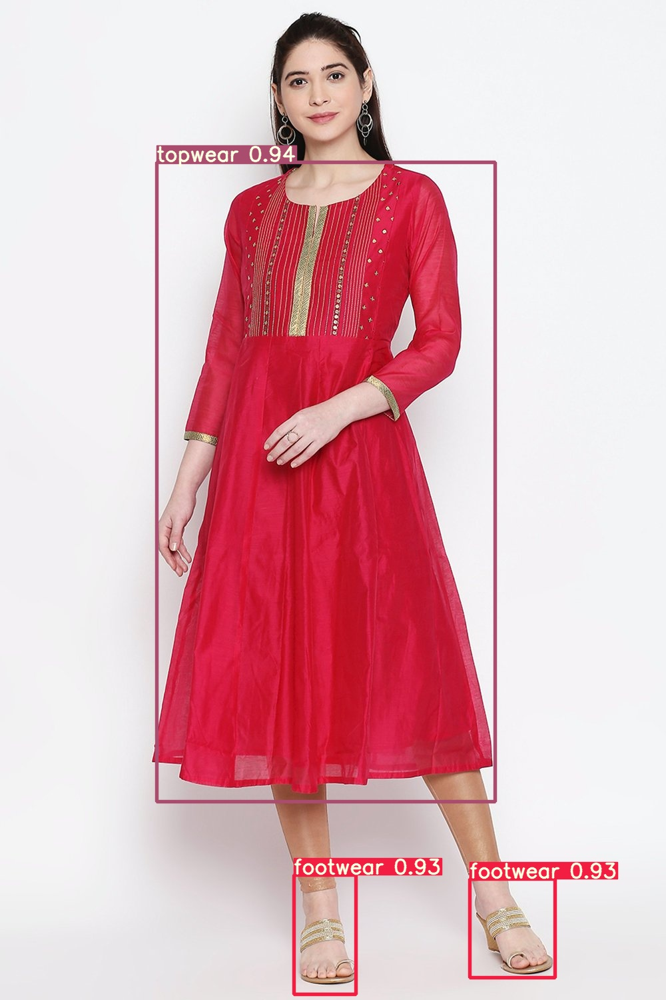

In [ ]:
from IPython.display import Image, clear_output
Image(filename='/content/yolov5/runs/detect/exp3/3cffb00f7d.jpg', width=600)